<a href="https://colab.research.google.com/github/Rak16-nub04/Machine-Learning/blob/main/cse445(cloud_coverage).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Library import

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

##classes within libraries

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split


#Dataset

In [ ]:
df = pd.read_csv("FloodPrediction.csv")

##dataset shape

In [ ]:
df = pd.read_csv("FloodPrediction.csv")
print(df.shape)


(20544, 19)


##shape visualization

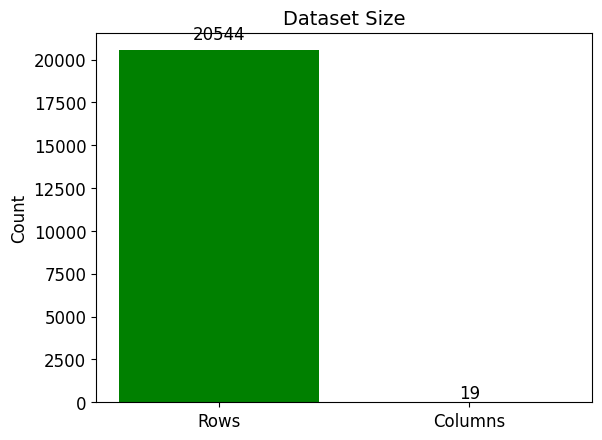

In [ ]:
rows, cols = df.shape

plt.bar(['Rows', 'Columns'], [rows, cols], color=['green', 'orange'])

plt.text(0, rows + rows * 0.02, str(rows), ha='center', va='bottom', fontsize=12)
plt.text(1, cols + cols * 0.02, str(cols), ha='center', va='bottom', fontsize=12)

plt.title("Dataset Size", fontsize=14)
plt.ylabel("Count", fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.show()

#Dataset Description

In [ ]:
df.head()

,Sl,Station_Names,Year,Month,Max_Temp,Min_Temp,Rainfall,Relative_Humidity,Wind_Speed,Cloud_Coverage,Bright_Sunshine,Station_Number,X_COR,Y_COR,LATITUDE,LONGITUDE,ALT,Period,Flood?
0,0,Barisal,1949,1,29.4,12.3,0.0,68.0,0.453704,0.6,7.831915,41950,536809.8,510151.9,22.7,90.36,4,1949.01,NaN
1,1,Barisal,1949,2,33.9,15.2,9.0,63.0,0.659259,0.9,8.314894,41950,536809.8,510151.9,22.7,90.36,4,1949.02,NaN
2,2,Barisal,1949,3,36.7,20.2,8.0,59.0,1.085185,1.5,8.131915,41950,536809.8,510151.9,22.7,90.36,4,1949.03,NaN
3,3,Barisal,1949,4,33.9,23.9,140.0,71.0,1.772222,3.9,8.219149,41950,536809.8,510151.9,22.7,90.36,4,1949.04,NaN
4,4,Barisal,1949,5,35.6,25.0,217.0,76.0,1.703704,4.1,7.046809,41950,536809.8,510151.9,22.7,90.36,4,1949.05,NaN


##dataset Attributes with visualization

Attributes:
1. Sl
2. Station_Names
3. Year
4. Month
5. Max_Temp
6. Min_Temp
7. Rainfall
8. Relative_Humidity
9. Wind_Speed
10. Cloud_Coverage
11. Bright_Sunshine
12. Station_Number
13. X_COR
14. Y_COR
15. LATITUDE
16. LONGITUDE
17. ALT
18. Period
19. Flood?


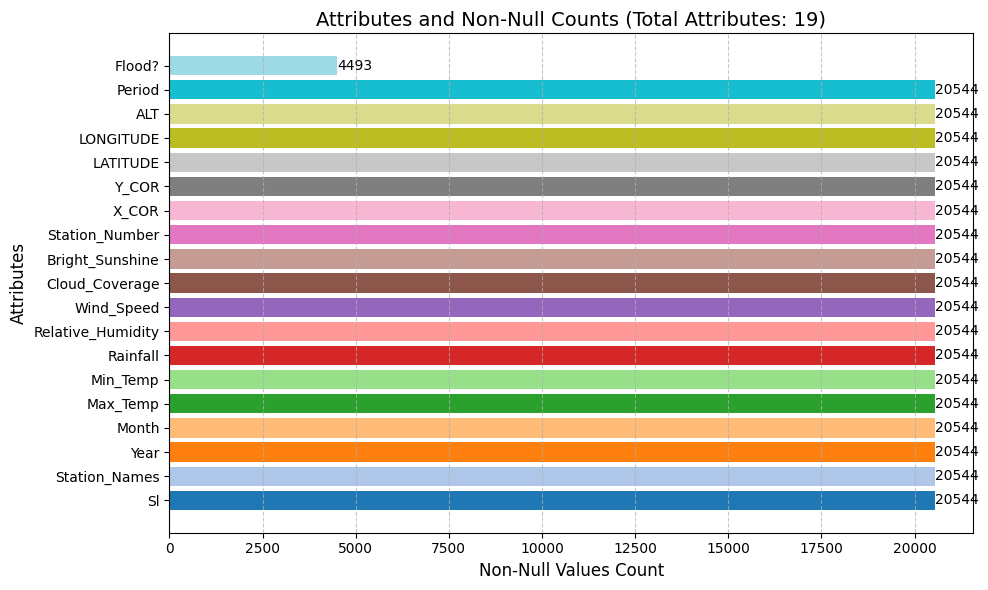

In [ ]:
attributes = df.columns.tolist()
num_attributes = len(attributes)
non_null_counts = [len(df[attr].dropna()) for attr in attributes]
colors = plt.cm.tab20(np.linspace(0, 1, num_attributes))

print("Attributes:")
for i, attr in enumerate(attributes, 1):
    print(f"{i}. {attr}")

plt.figure(figsize=(10, 6))
bars = plt.barh(attributes, non_null_counts, color=colors)

for bar, count in zip(bars, non_null_counts):
    plt.text(count + 1, bar.get_y() + bar.get_height() / 2, str(count),
             va='center', fontsize=10)

plt.xlabel("Non-Null Values Count", fontsize=12)
plt.ylabel("Attributes", fontsize=12)
plt.title(f"Attributes and Non-Null Counts (Total Attributes: {num_attributes})", fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


##data type and null values

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20544 entries, 0 to 20543
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Sl                 20544 non-null  int64  
 1   Station_Names      20544 non-null  object 
 2   Year               20544 non-null  int64  
 3   Month              20544 non-null  int64  
 4   Max_Temp           20544 non-null  float64
 5   Min_Temp           20544 non-null  float64
 6   Rainfall           20544 non-null  float64
 7   Relative_Humidity  20544 non-null  float64
 8   Wind_Speed         20544 non-null  float64
 9   Cloud_Coverage     20544 non-null  float64
 10  Bright_Sunshine    20544 non-null  float64
 11  Station_Number     20544 non-null  int64  
 12  X_COR              20544 non-null  float64
 13  Y_COR              20544 non-null  float64
 14  LATITUDE           20544 non-null  float64
 15  LONGITUDE          20544 non-null  float64
 16  ALT                205

##missing values

In [ ]:
missing_values = df.isnull().sum()
print(missing_values)

Sl                       0
Station_Names            0
Year                     0
Month                    0
Max_Temp                 0
Min_Temp                 0
Rainfall                 0
Relative_Humidity        0
Wind_Speed               0
Cloud_Coverage           0
Bright_Sunshine          0
Station_Number           0
X_COR                    0
Y_COR                    0
LATITUDE                 0
LONGITUDE                0
ALT                      0
Period                   0
Flood?               16051
dtype: int64


#Locations of the data

In [ ]:
import folium
from folium.plugins import HeatMap

##all the locations of the data

In [ ]:
flood_data = df[df['Cloud_Coverage'] > 0]

location_data = df.groupby(['LATITUDE', 'LONGITUDE'])['Cloud_Coverage'].mean().reset_index()
location_data['Cloud_Coverage_Percentage'] = location_data['Cloud_Coverage'] * 100

m = folium.Map(location=[location_data['LATITUDE'].mean(), location_data['LONGITUDE'].mean()], zoom_start=6)

heat_data = [
    [row['LATITUDE'], row['LONGITUDE'], row['Cloud_Coverage_Percentage']] for index, row in location_data.iterrows()
]

HeatMap(heat_data, radius=10, blur=15, max_zoom=1).add_to(m)

for index, row in location_data.iterrows():
    tooltip_text = f"Cloud_Coverage Percentage: {row['Cloud_Coverage_Percentage']:.2f}%"
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=tooltip_text
    ).add_to(m)

m


##location with cloud_coverage values


In [ ]:
m = folium.Map(location=[df['LATITUDE'].mean(), df['LONGITUDE'].mean()], zoom_start=6)

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=row['Cloud_Coverage'] * 2,
        color='red',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f"{row['Station_Number']}: Cloud Coverage {row['Cloud_Coverage']}"
    ).add_to(m)

m


#Pre-processing

##Correlation matrix heatmap

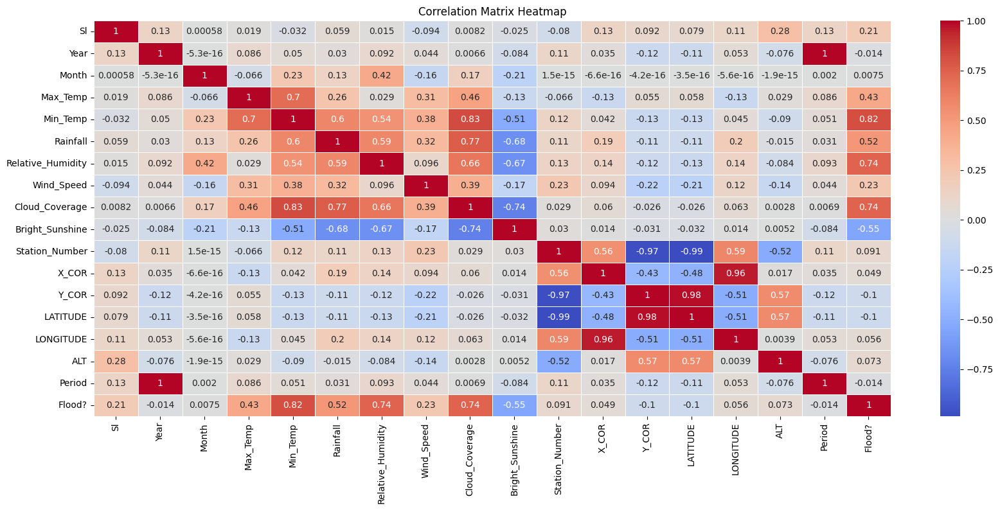

In [ ]:
numeric_df = df.select_dtypes(include=['number'])

correlation_matrix = numeric_df.corr()

plt.figure(figsize=(20, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", linewidths=0.5)
plt.title("Correlation Matrix Heatmap")
plt.show()


##drop (attributes)

In [ ]:
df = df.drop(columns=["Sl", "Station_Names", "Flood?", "Period"])


##drop visualization visualization

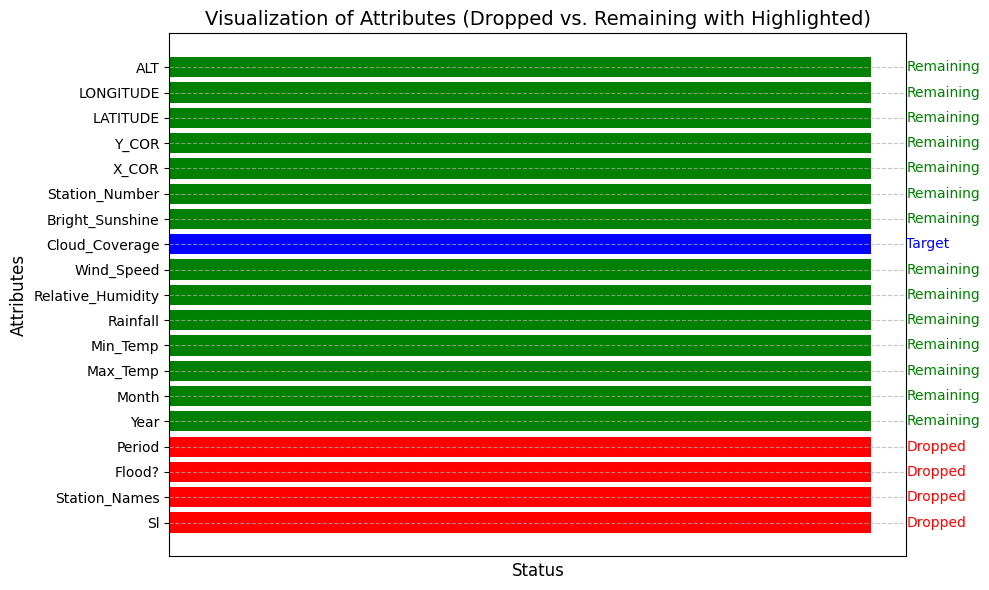

In [ ]:
dropped_columns = ["Sl", "Station_Names", "Flood?", "Period"]

remaining_columns = [col for col in df.columns]

all_columns = dropped_columns + remaining_columns
statuses = ["Dropped"] * len(dropped_columns) + ["Remaining"] * len(remaining_columns)

highlight_attribute = "Cloud_Coverage"

colors = [
    "red" if col in dropped_columns
    else "blue" if col == highlight_attribute
    else "green"
    for col in all_columns
]

plt.figure(figsize=(10, 6))
plt.barh(all_columns, [1] * len(all_columns), color=colors)

for i, (col, status) in enumerate(zip(all_columns, statuses + ["Remaining"] * len(remaining_columns))):
    label_color = "blue" if col == highlight_attribute else colors[i]
    plt.text(1.05, i, status if col not in remaining_columns or col != highlight_attribute else "Target",
             va='center', fontsize=10, color=label_color)

plt.title("Visualization of Attributes (Dropped vs. Remaining with Highlighted)", fontsize=14)
plt.xlabel("Status", fontsize=12)
plt.ylabel("Attributes", fontsize=12)
plt.xticks([])
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


##after preprocessing

In [ ]:
df.describe()

,Year,Month,Max_Temp,Min_Temp,Rainfall,Relative_Humidity,Wind_Speed,Cloud_Coverage,Bright_Sunshine,Station_Number,X_COR,Y_COR,LATITUDE,LONGITUDE,ALT
count,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000,20544.000000
mean,1985.332944,6.500000,33.450739,21.166872,198.776621,79.497375,1.415049,3.485827,6.419056,41935.098131,549703.189176,579280.955958,23.326647,90.493193,13.357477
std,17.610799,3.452137,2.956401,4.949587,240.693197,7.667925,1.042454,2.083791,1.747959,36.516932,116032.076255,130616.053201,1.155241,1.108720,13.529530
min,1948.000000,1.000000,21.600000,6.200000,0.000000,34.000000,0.000000,0.000000,0.000000,41859.000000,0.000000,0.000000,20.870000,88.560000,0.000000
25%,1972.000000,3.750000,31.700000,16.900000,8.000000,75.000000,0.700000,1.600000,4.965517,41909.000000,435303.700000,504500.300000,22.640000,89.550000,4.000000
50%,1987.000000,6.500000,33.900000,23.400000,111.000000,81.000000,1.200000,3.300000,6.800000,41941.000000,540098.600000,561770.300000,23.170000,90.410000,7.000000
75%,2000.000000,9.250000,35.400000,25.400000,312.000000,85.000000,1.900000,5.500000,7.800000,41963.000000,650012.100000,687095.900000,24.290000,91.460000,19.000000
max,2013.000000,12.000000,44.000000,28.100000,2072.000000,97.000000,11.200000,7.900000,11.000000,41998.000000,734765.400000,844822.300000,25.720000,92.260000,63.000000


#cloud_coverage info

##cloud_coverage all unique values

In [ ]:
unique_cloud_coverage = df['Cloud_Coverage'].unique()

print(unique_cloud_coverage)

[0.6        0.9        1.5        3.9        4.1        5.6
 5.4        4.8        3.1        0.3        0.8        1.7
 2.9        3.3        7.2        6.8        7.4        6.5
 5.8        4.         4.6        6.7        7.3        5.5
 2.5        2.1        1.         2.4        3.7        4.7
 6.2        6.4        3.6        2.         1.6        2.2
 5.3        6.9        6.1        3.         1.4        0.5
 3.8        6.6        4.3        0.4        1.2        1.8
 2.6        6.3        5.7        1.3        0.2        2.3
 4.2        3.2        4.9        6.         4.4        5.
 5.9        2.7        3.5        3.4        1.9        5.1
 7.1        7.         4.5        7.8        0.7        2.8
 5.2        0.1        1.1        7.6        7.5        7.7
 0.         7.9        0.95172414 1.21034483 1.90689655 2.86551724
 5.95862069 6.43448276 6.19655172 5.5137931  3.64137931 1.9137931
 1.13448276 1.04782609 1.36521739 2.03043478 3.19565217 4.22608696
 5.59130435 5.9347826

##cloud_coverage values (sorted)

In [ ]:
sorted_cloud_coverage = sorted(unique_cloud_coverage)

num_columns = 5

df_cloud_coverage = pd.DataFrame(
    [sorted_cloud_coverage[i:i + num_columns] for i in range(0, len(sorted_cloud_coverage), num_columns)]
)

print(df_cloud_coverage.to_string(index=False, header=False))

0.000000 0.100000 0.200000 0.300000 0.400000
0.500000 0.600000 0.700000 0.800000 0.880435
0.900000 0.930435 0.951724 1.000000 1.013043
1.047826 1.100000 1.134483 1.200000 1.210345
1.300000 1.365217 1.395652 1.400000 1.500000
1.600000 1.700000 1.795652 1.800000 1.863043
1.900000 1.906897 1.913793 2.000000 2.030435
2.100000 2.147826 2.200000 2.300000 2.400000
2.500000 2.600000 2.700000 2.800000 2.865517
2.900000 3.000000 3.100000 3.119565 3.132609
3.195652 3.200000 3.300000 3.400000 3.482609
3.500000 3.600000 3.641379 3.700000 3.800000
3.900000 4.000000 4.100000 4.123913 4.200000
4.226087 4.300000 4.400000 4.500000 4.600000
4.700000 4.800000 4.845652 4.900000 5.000000
5.100000 5.200000 5.213043 5.300000 5.400000
5.500000 5.513793 5.545652 5.591304 5.600000
5.667391 5.695652 5.700000 5.800000 5.900000
5.910870 5.934783 5.958621 6.000000 6.100000
6.196552 6.200000 6.300000 6.400000 6.434483
6.500000 6.600000 6.700000 6.800000 6.900000
7.000000 7.100000 7.200000 7.300000 7.400000
7.500000 7

##sorted values visualization

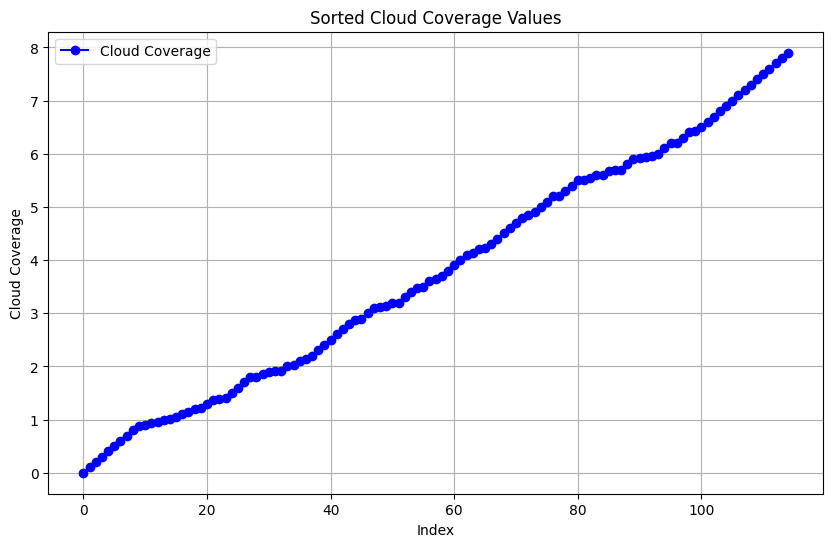

In [ ]:
num_columns = 5

df_cloud_coverage = pd.DataFrame(
    [sorted_cloud_coverage[i:i + num_columns] for i in range(0, len(sorted_cloud_coverage), num_columns)]
)

flattened_data = [item for sublist in df_cloud_coverage.values.tolist() for item in sublist]

plt.figure(figsize=(10, 6))
plt.plot(flattened_data, marker='o', linestyle='-', color='b', label="Cloud Coverage")
plt.title("Sorted Cloud Coverage Values")
plt.xlabel("Index")
plt.ylabel("Cloud Coverage")
plt.grid(True)
plt.legend()
plt.show()


##value conunts

In [ ]:
cloud_coverage_counts = df['Cloud_Coverage'].value_counts()
print(cloud_coverage_counts)

Cloud_Coverage
5.900000    443
0.900000    438
6.200000    429
1.200000    420
1.500000    419
           ... 
3.195652      2
2.030435      2
1.047826      2
7.900000      2
7.800000      1
Name: count, Length: 115, dtype: int64


##value counts visualization

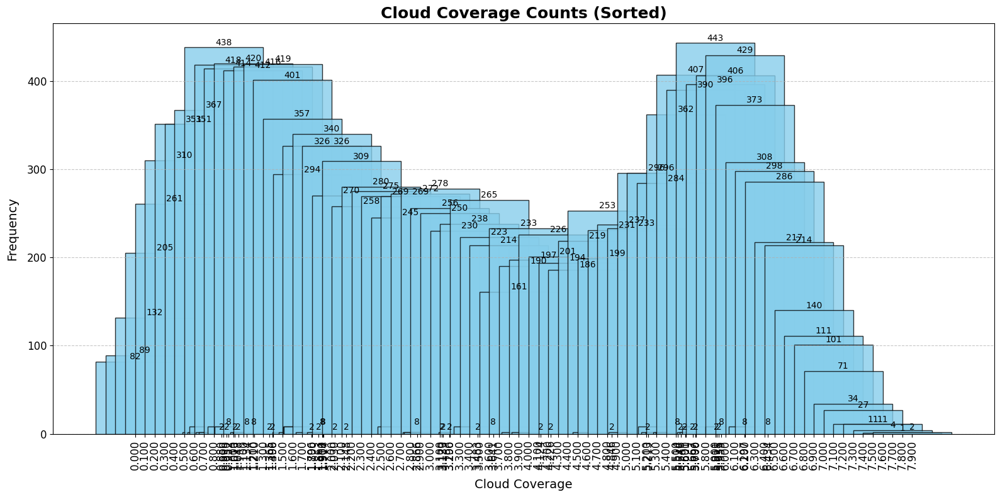

In [ ]:
cloud_coverage_counts = df['Cloud_Coverage'].value_counts().sort_index()

plt.figure(figsize=(16, 8))
bars = plt.bar(cloud_coverage_counts.index, cloud_coverage_counts.values, color='skyblue', edgecolor='black', alpha=0.8)

for bar in bars:
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        bar.get_height() + 0.5,
        f'{int(bar.get_height())}',
        ha='center', va='bottom', fontsize=10
    )

plt.title("Cloud Coverage Counts (Sorted)", fontsize=18, weight='bold')
plt.xlabel("Cloud Coverage", fontsize=14, labelpad=10)
plt.ylabel("Frequency", fontsize=14, labelpad=10)
plt.xticks(ticks=cloud_coverage_counts.index, fontsize=12, rotation=90)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


#More Libraries for upcoming tasks

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

#random Forest Regressor

##Feature importance

              Feature  Importance
4            Rainfall    0.687031
7     Bright_Sunshine    0.109286
3            Min_Temp    0.102550
1               Month    0.023893
0                Year    0.018448
6          Wind_Speed    0.013680
5   Relative_Humidity    0.011862
2            Max_Temp    0.010900
12          LONGITUDE    0.004315
9               X_COR    0.004281
13                ALT    0.004239
8      Station_Number    0.004135
10              Y_COR    0.002804
11           LATITUDE    0.002577


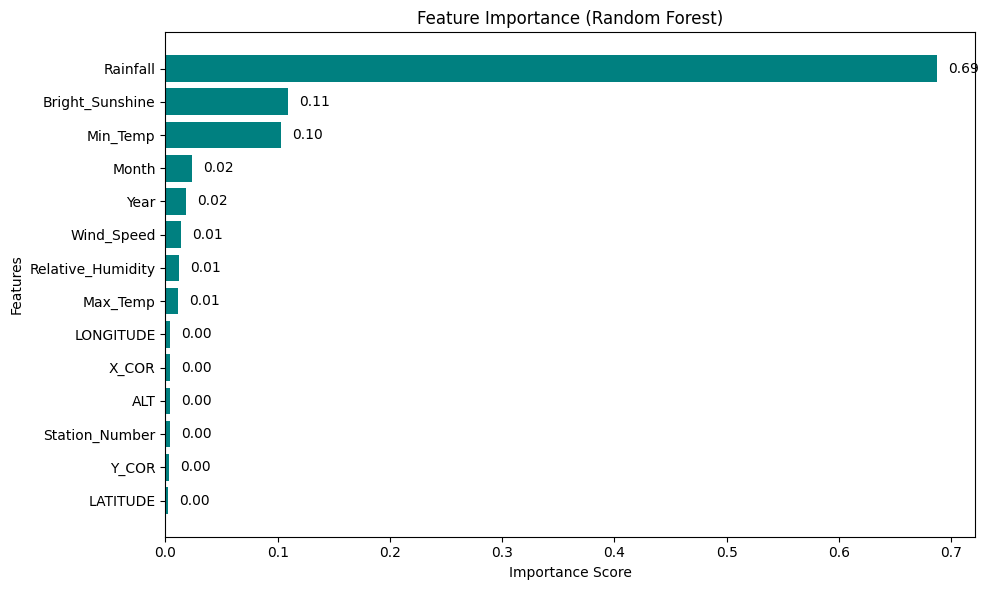

In [ ]:
from sklearn.ensemble import RandomForestRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = RandomForestRegressor(random_state=42)
model.fit(X, y)

feature_importances = model.feature_importances_

feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

print(feature_importance_df)

plt.figure(figsize=(10, 6))
bars = plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='teal')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.title('Feature Importance (Random Forest)')
plt.gca().invert_yaxis()

for bar in bars:
    plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height() / 2,
             f'{bar.get_width():.2f}', va='center', ha='left', color='black', fontsize=10)

plt.tight_layout()
plt.show()


##Cross validation & Metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.321149  0.566700  0.414501  0.927914
1     2  0.322984  0.568317  0.406123  0.924337
2     3  0.295572  0.543665  0.405297  0.931421
3     4  0.369096  0.607533  0.432166  0.914867
4     5  0.345138  0.587484  0.422739  0.920953
5     6  0.322743  0.568105  0.412229  0.924067
6     7  0.326520  0.571419  0.409691  0.926251
7     8  0.342346  0.585103  0.417016  0.919254
8     9  0.376449  0.613554  0.427595  0.914991
9    10  0.307482  0.554510  0.404492  0.928936


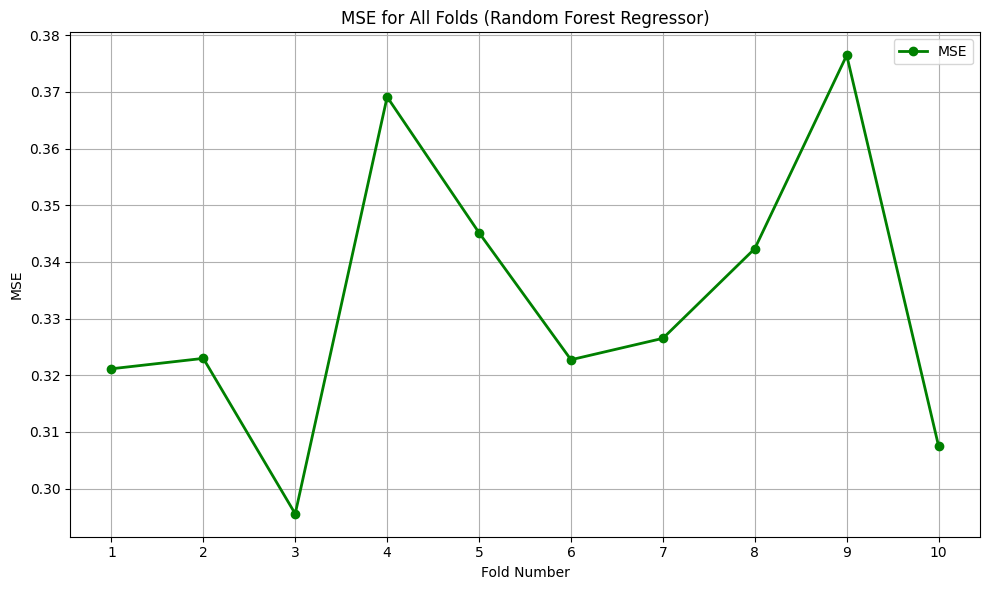

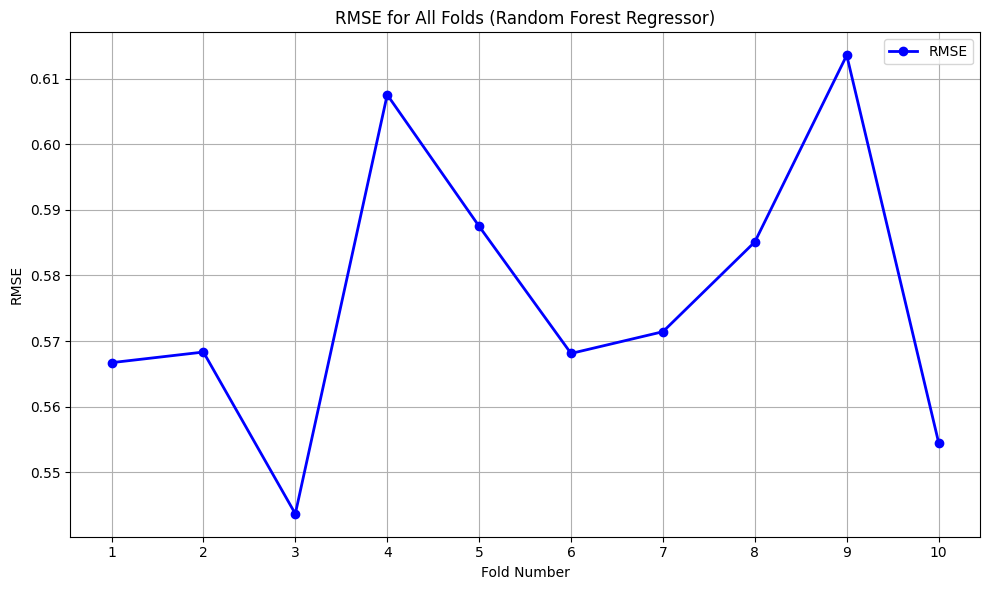

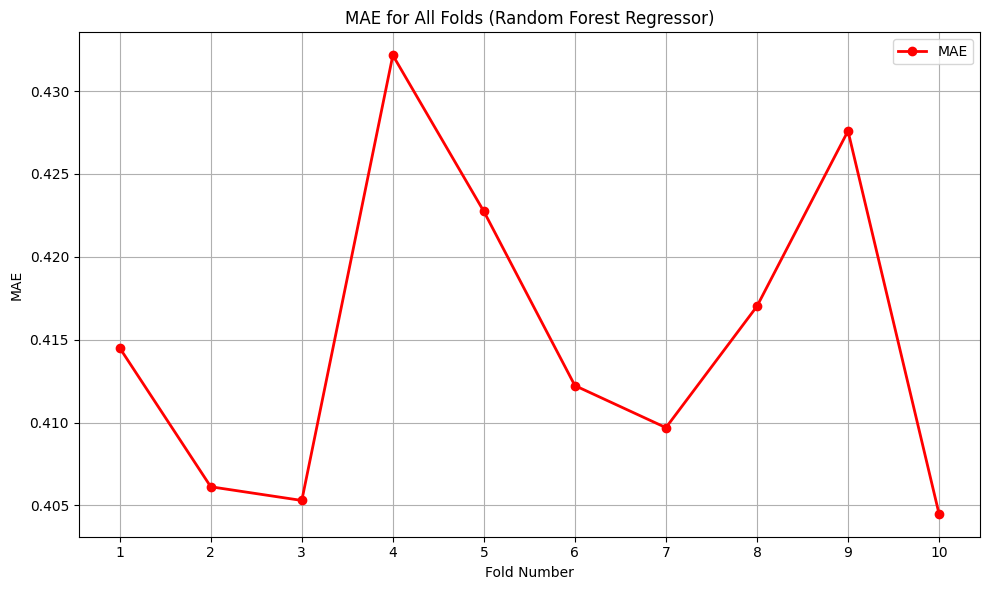

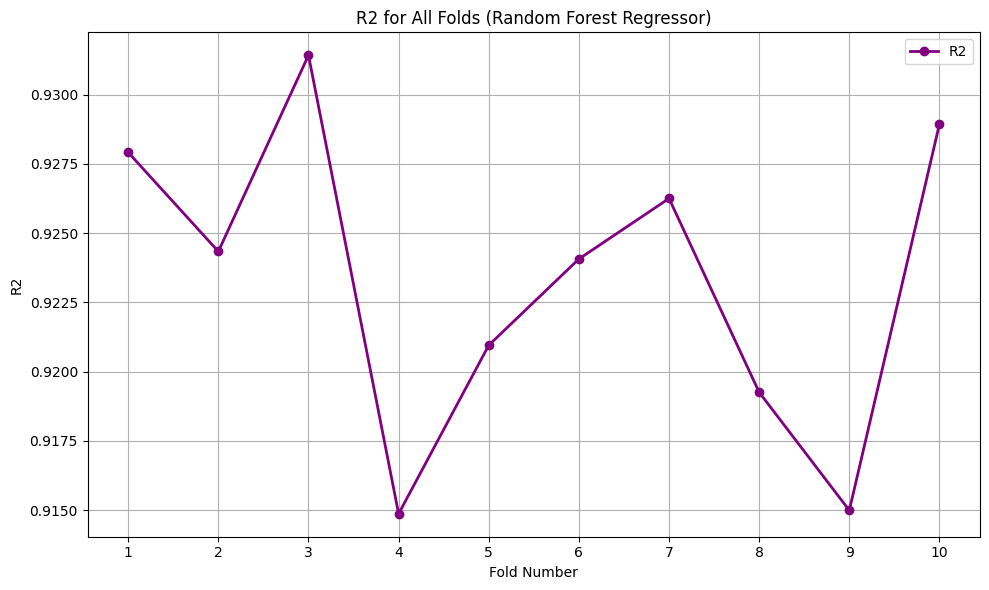


Best Fold Metrics (Fold 3.0):
Fold    3.000000
MSE     0.295572
RMSE    0.543665
MAE     0.405297
R2      0.931421
Name: 2, dtype: float64


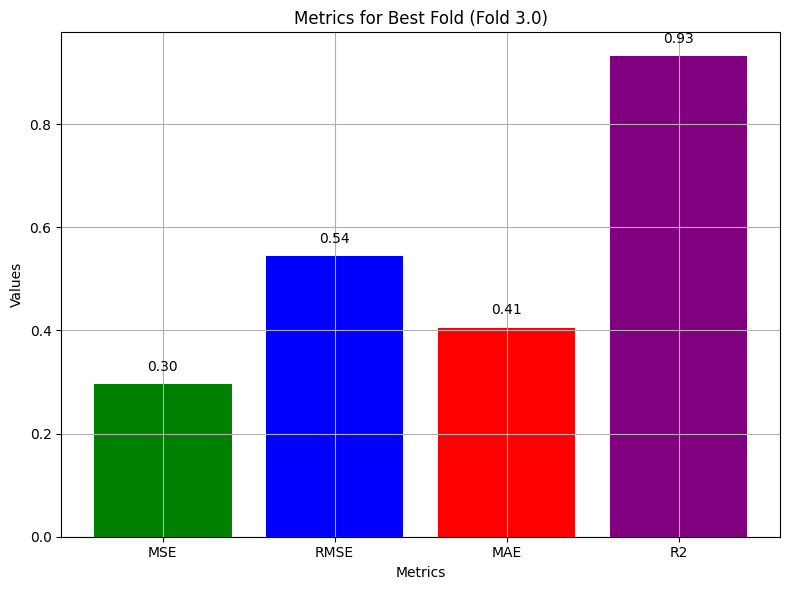

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


model = RandomForestRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)


fold_results = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)


    model.fit(X_train_scaled, y_train)


    y_pred = model.predict(X_test_scaled)


    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)


    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })


fold_results_df = pd.DataFrame(fold_results)


best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]


print(fold_results_df)


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (Random Forest Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (Random Forest Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (Random Forest Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (Random Forest Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")


metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]


fig, ax = plt.subplots(figsize=(8, 6))

bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])


for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)


ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)


plt.tight_layout()
plt.show()


##actual vs predicted values graph

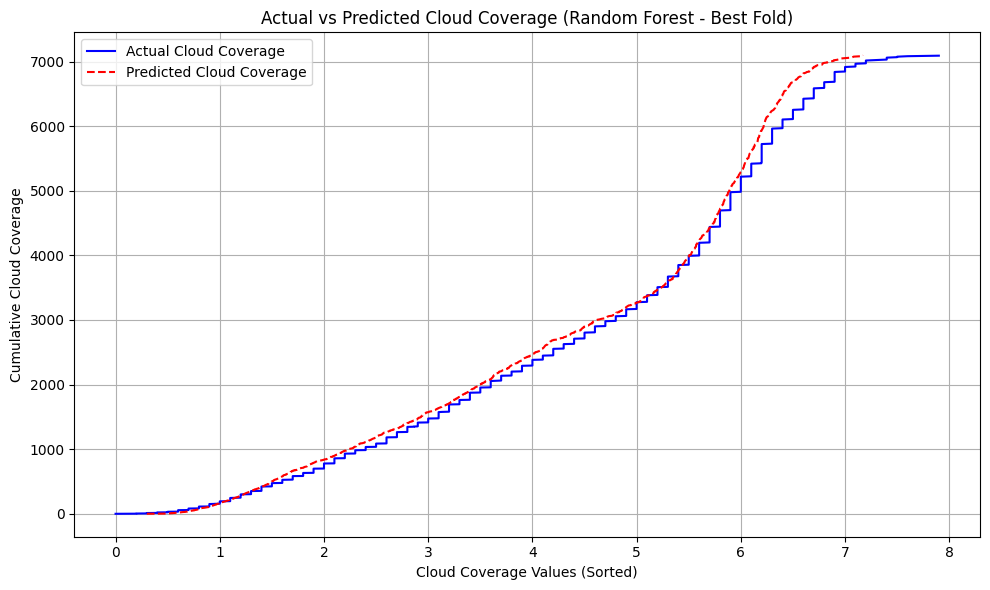

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = RandomForestRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for train_index, test_index in kf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))

best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

y_test_sorted = np.sort(y_test_best)
y_pred_sorted = np.sort(y_pred_best)

plt.figure(figsize=(10, 6))
plt.plot(y_test_sorted, np.cumsum(y_test_sorted), label='Actual Cloud Coverage', color='blue', linestyle='-', linewidth=1.5)
plt.plot(y_pred_sorted, np.cumsum(y_pred_sorted), label='Predicted Cloud Coverage', color='red', linestyle='--', linewidth=1.5)

plt.xlabel('Cloud Coverage Values (Sorted)')
plt.ylabel('Cumulative Cloud Coverage')
plt.title('Actual vs Predicted Cloud Coverage (Random Forest - Best Fold)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


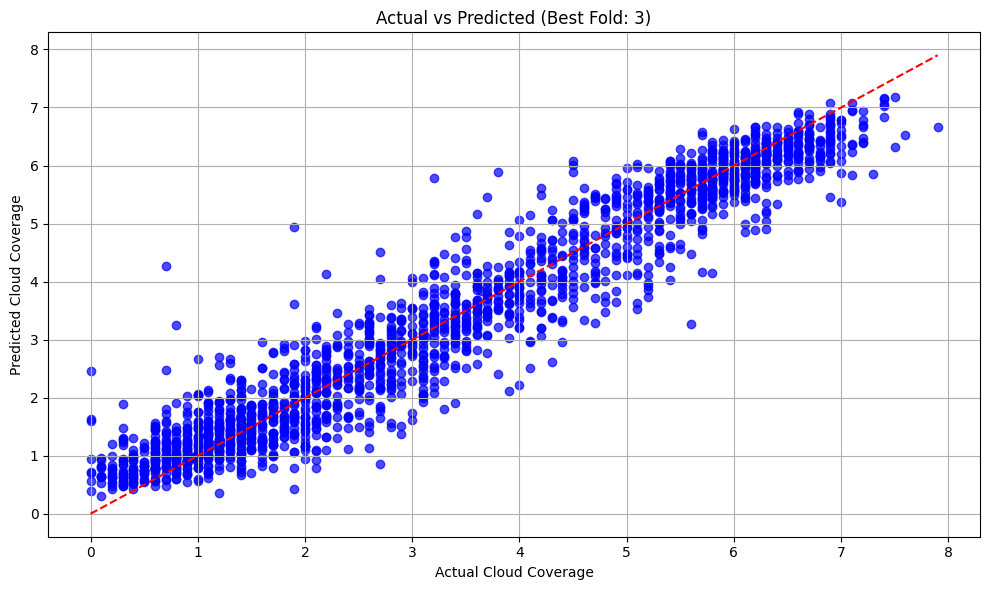

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = RandomForestRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))

best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

plt.figure(figsize=(10, 6))
plt.scatter(y_test_best, y_pred_best, color='blue', alpha=0.7)
plt.plot([min(y_test_best), max(y_test_best)], [min(y_test_best), max(y_test_best)], color='red', linestyle='--')
plt.xlabel('Actual Cloud Coverage')
plt.ylabel('Predicted Cloud Coverage')
plt.title(f'Actual vs Predicted (Best Fold: {best_fold_index + 1})')
plt.grid(True)
plt.tight_layout()
plt.show()


Fold 1: RMSE = 0.5667
Fold 2: RMSE = 0.5683
Fold 3: RMSE = 0.5437
Fold 4: RMSE = 0.6075
Fold 5: RMSE = 0.5875
Fold 6: RMSE = 0.5681
Fold 7: RMSE = 0.5714
Fold 8: RMSE = 0.5851
Fold 9: RMSE = 0.6136
Fold 10: RMSE = 0.5545
Best Fold: 3 with RMSE = 0.5437


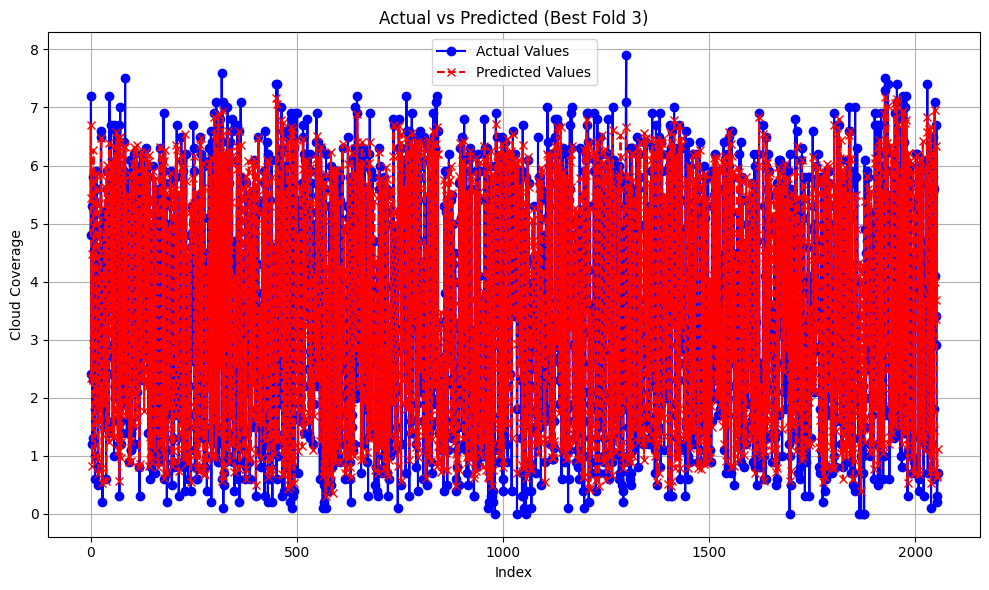

In [ ]:
from sklearn.metrics import mean_squared_error
import numpy as np
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = RandomForestRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

all_actual = []
all_predicted = []
fold_rmse = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    all_actual.extend(y_test)
    all_predicted.extend(y_pred)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)

    print(f"Fold {fold}: RMSE = {rmse:.4f}")

best_fold = np.argmin(fold_rmse) + 1
print(f"Best Fold: {best_fold} with RMSE = {fold_rmse[best_fold - 1]:.4f}")

kf_split = kf.split(X, y)
for fold, (train_index, test_index) in enumerate(kf_split, start=1):
    if fold == best_fold:
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        plt.figure(figsize=(10, 6))
        plt.plot(range(len(y_test)), y_test, label='Actual Values', color='blue', linestyle='-', marker='o')
        plt.plot(range(len(y_pred)), y_pred, label='Predicted Values', color='red', linestyle='--', marker='x')
        plt.xlabel('Index')
        plt.ylabel('Cloud Coverage')
        plt.title(f'Actual vs Predicted (Best Fold {best_fold})')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        break


#XGBoost

##feature importance

              Feature  Importance
4            Rainfall    0.620650
7     Bright_Sunshine    0.119716
3            Min_Temp    0.097020
1               Month    0.047127
12          LONGITUDE    0.016347
9               X_COR    0.016098
13                ALT    0.014318
5   Relative_Humidity    0.013608
8      Station_Number    0.013411
10              Y_COR    0.012317
6          Wind_Speed    0.011872
0                Year    0.008302
11           LATITUDE    0.004782
2            Max_Temp    0.004430


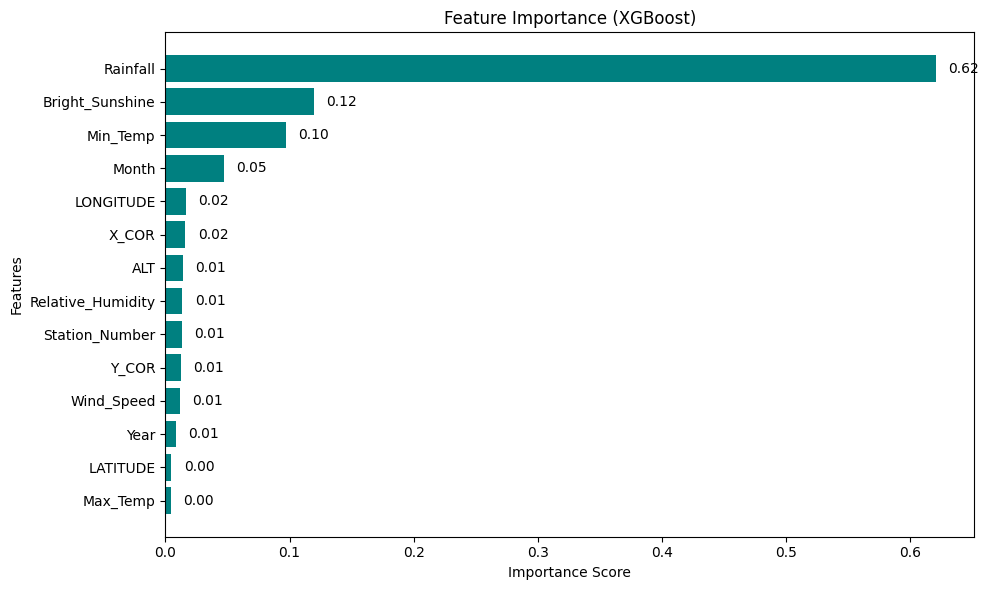

In [ ]:
from xgboost import XGBRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = XGBRegressor(random_state=42)
model.fit(X, y)

feature_importances = model.feature_importances_

feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

print(feature_importance_df)

plt.figure(figsize=(10, 6))
bars = plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='teal')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.title('Feature Importance (XGBoost)')
plt.gca().invert_yaxis()

for bar in bars:
    plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height() / 2,
             f'{bar.get_width():.2f}', va='center', ha='left', color='black', fontsize=10)

plt.tight_layout()
plt.show()


##cross validation & metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.237068  0.486896  0.361956  0.946787
1     2  0.250738  0.500737  0.368924  0.941262
2     3  0.225574  0.474946  0.361704  0.947662
3     4  0.266149  0.515896  0.373524  0.938612
4     5  0.251488  0.501486  0.372988  0.942401
5     6  0.254025  0.504009  0.374194  0.940234
6     7  0.247845  0.497840  0.366352  0.944021
7     8  0.255372  0.505343  0.370705  0.939768
8     9  0.287617  0.536299  0.381685  0.935051
9    10  0.232908  0.482606  0.360339  0.946171


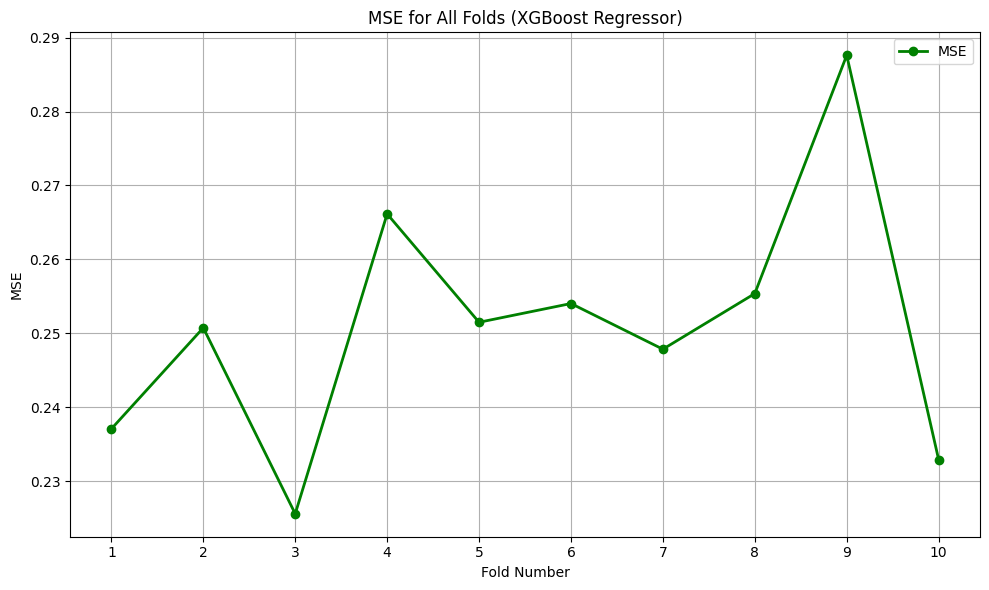

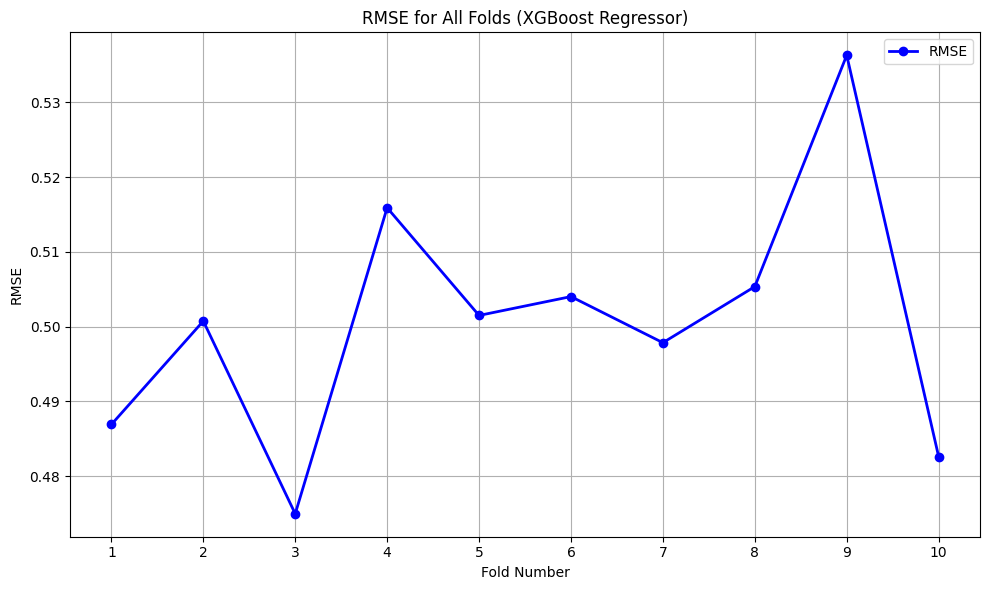

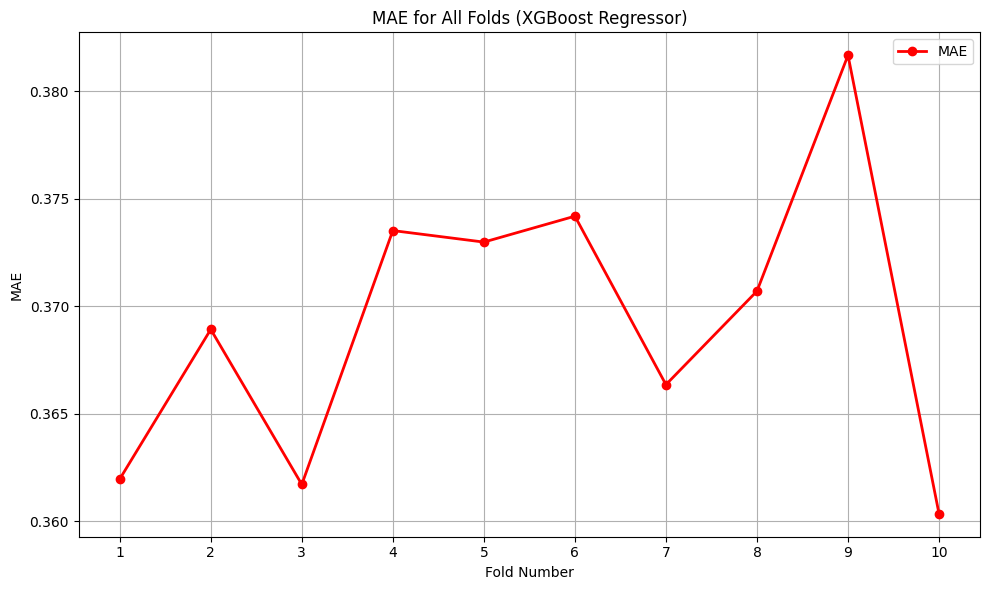

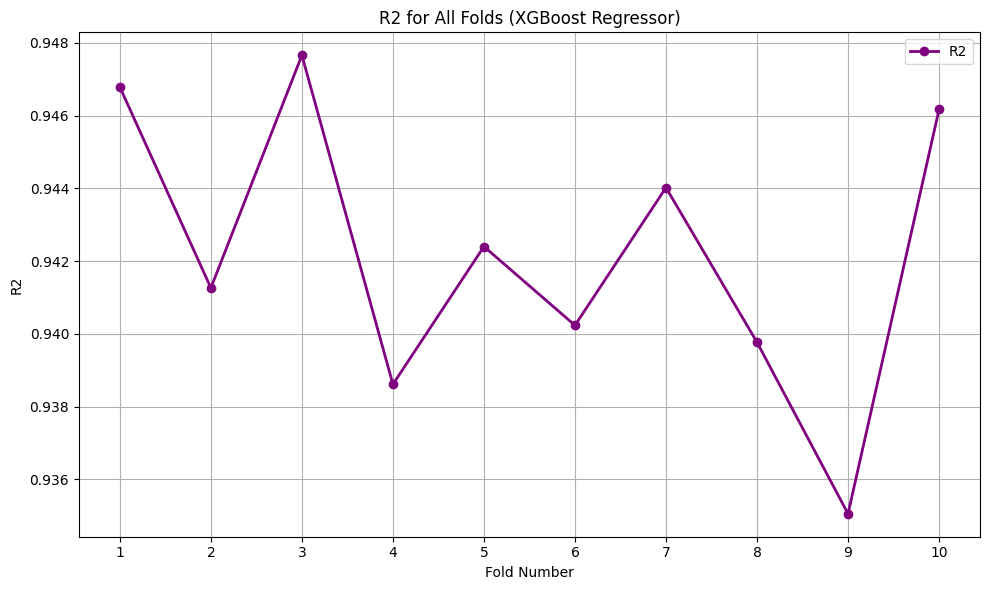


Best Fold Metrics (Fold 3.0):
Fold    3.000000
MSE     0.225574
RMSE    0.474946
MAE     0.361704
R2      0.947662
Name: 2, dtype: float64


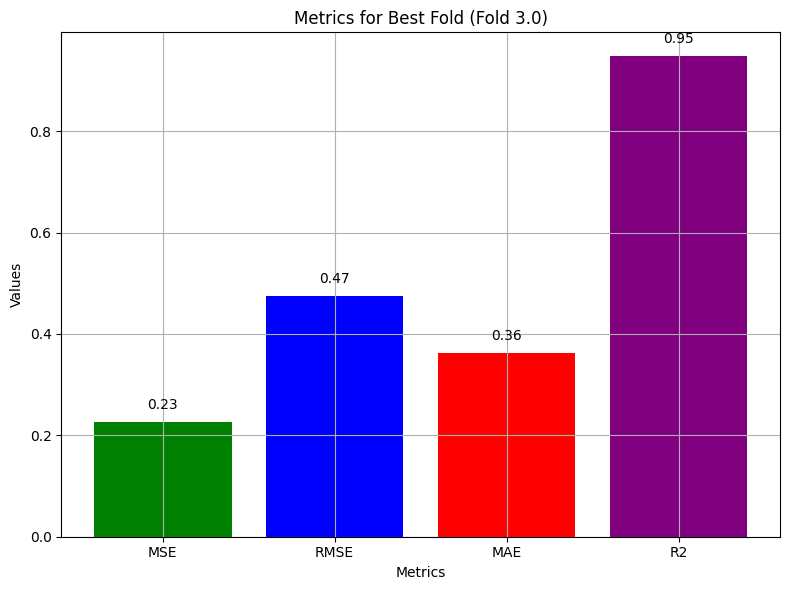

In [ ]:
import xgboost as xgb
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = xgb.XGBRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_results = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)


    model.fit(X_train_scaled, y_train)


    y_pred = model.predict(X_test_scaled)


    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)


    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })


fold_results_df = pd.DataFrame(fold_results)


best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]


print(fold_results_df)




plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (XGBoost Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (XGBoost Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (XGBoost Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (XGBoost Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")

# Bar Plot for Best Fold Metrics
metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])

# Display the values on top of the bars
for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)

ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)
plt.tight_layout()
plt.show()



##Actual values vs predicted values graph

Best Fold: 3 with RMSE = 0.4749


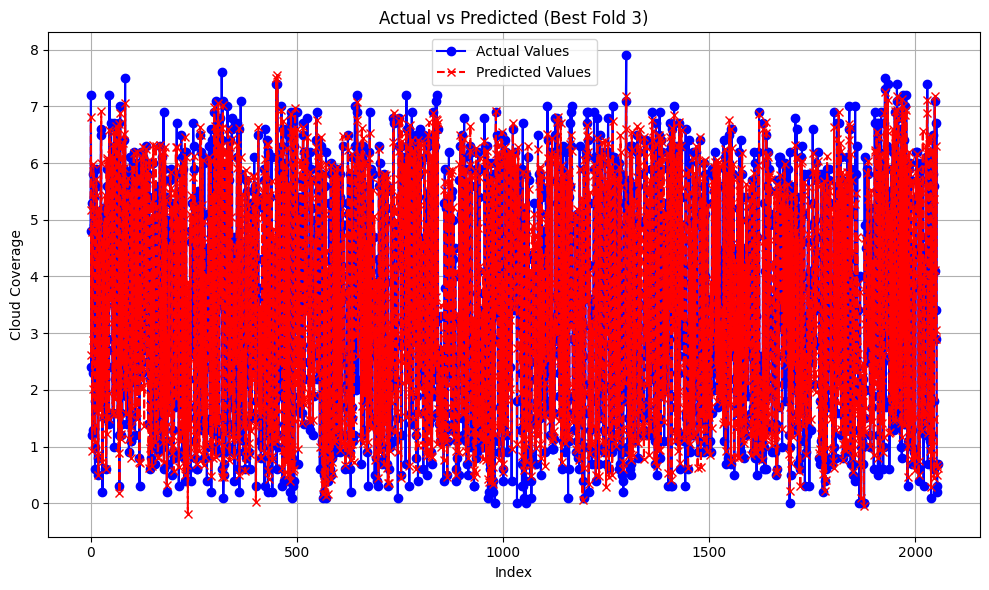

In [ ]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = XGBRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

all_actual = []
all_predicted = []
fold_rmse = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    all_actual.extend(y_test)
    all_predicted.extend(y_pred)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)



best_fold = np.argmin(fold_rmse) + 1
print(f"Best Fold: {best_fold} with RMSE = {fold_rmse[best_fold - 1]:.4f}")

kf_split = kf.split(X, y)
for fold, (train_index, test_index) in enumerate(kf_split, start=1):
    if fold == best_fold:
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        plt.figure(figsize=(10, 6))
        plt.plot(range(len(y_test)), y_test, label='Actual Values', color='blue', linestyle='-', marker='o')
        plt.plot(range(len(y_pred)), y_pred, label='Predicted Values', color='red', linestyle='--', marker='x')
        plt.xlabel('Index')
        plt.ylabel('Cloud Coverage')
        plt.title(f'Actual vs Predicted (Best Fold {best_fold})')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        break


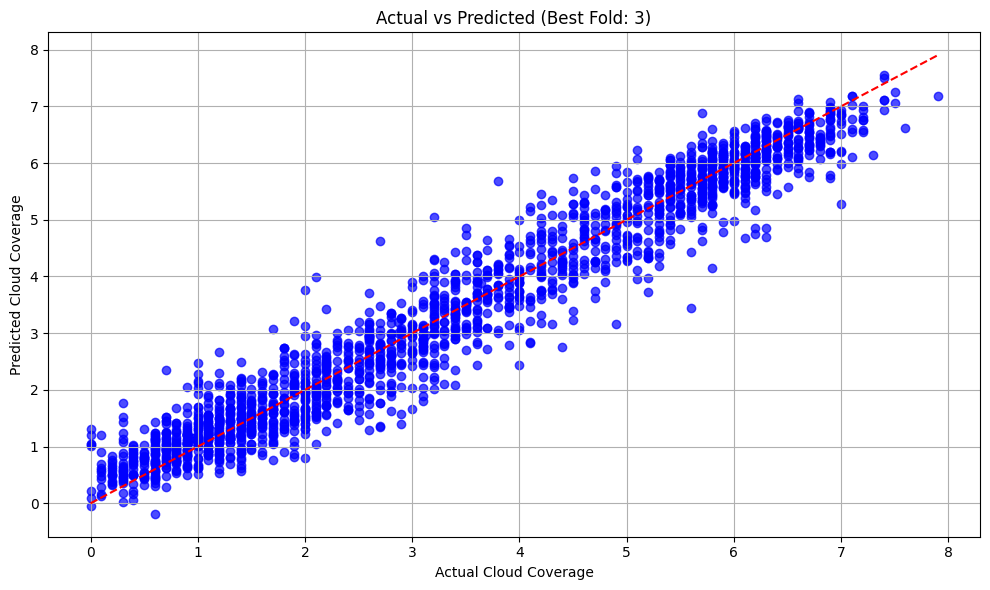

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from xgboost import XGBRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = XGBRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))


best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

plt.figure(figsize=(10, 6))
plt.scatter(y_test_best, y_pred_best, color='blue', alpha=0.7)
plt.plot([min(y_test_best), max(y_test_best)], [min(y_test_best), max(y_test_best)], color='red', linestyle='--')
plt.xlabel('Actual Cloud Coverage')
plt.ylabel('Predicted Cloud Coverage')
plt.title(f'Actual vs Predicted (Best Fold: {best_fold_index + 1})')
plt.grid(True)
plt.tight_layout()
plt.show()


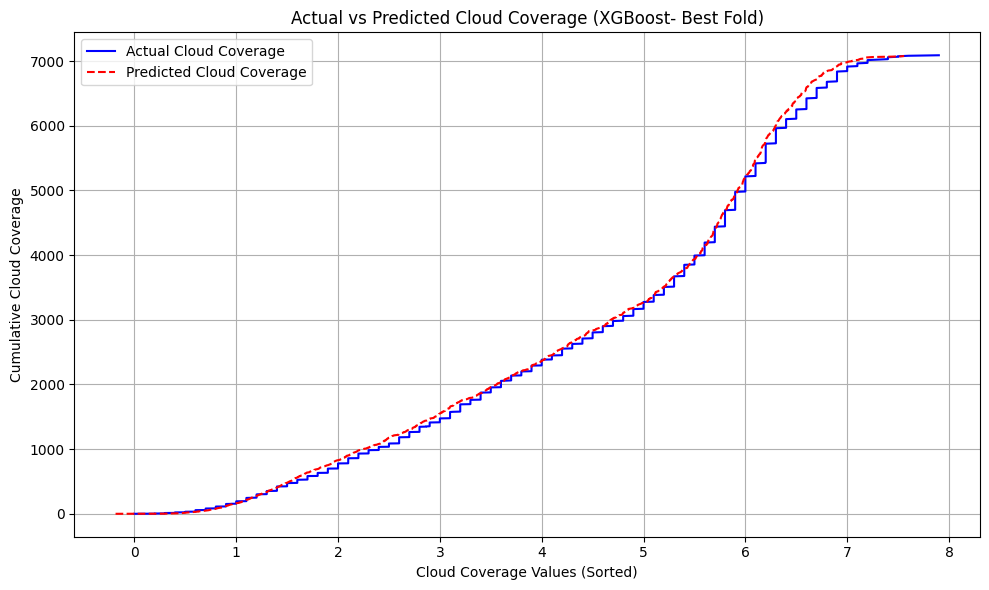

In [ ]:

from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error


X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = XGBRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for train_index, test_index in kf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))


best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]


y_test_sorted = np.sort(y_test_best)
y_pred_sorted = np.sort(y_pred_best)


plt.figure(figsize=(10, 6))
plt.plot(y_test_sorted, np.cumsum(y_test_sorted), label='Actual Cloud Coverage', color='blue', linestyle='-', linewidth=1.5)
plt.plot(y_pred_sorted, np.cumsum(y_pred_sorted), label='Predicted Cloud Coverage', color='red', linestyle='--', linewidth=1.5)

plt.xlabel('Cloud Coverage Values (Sorted)')
plt.ylabel('Cumulative Cloud Coverage')
plt.title('Actual vs Predicted Cloud Coverage (XGBoost- Best Fold)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


> Add blockquote

> Add blockquote





#Decision Tree Regressor


##Feature importance

              Feature  Importance
4            Rainfall    0.689399
7     Bright_Sunshine    0.103949
3            Min_Temp    0.101170
1               Month    0.023953
0                Year    0.020080
6          Wind_Speed    0.013850
5   Relative_Humidity    0.013483
2            Max_Temp    0.010835
9               X_COR    0.005182
13                ALT    0.004638
12          LONGITUDE    0.003890
8      Station_Number    0.003692
10              Y_COR    0.003003
11           LATITUDE    0.002875


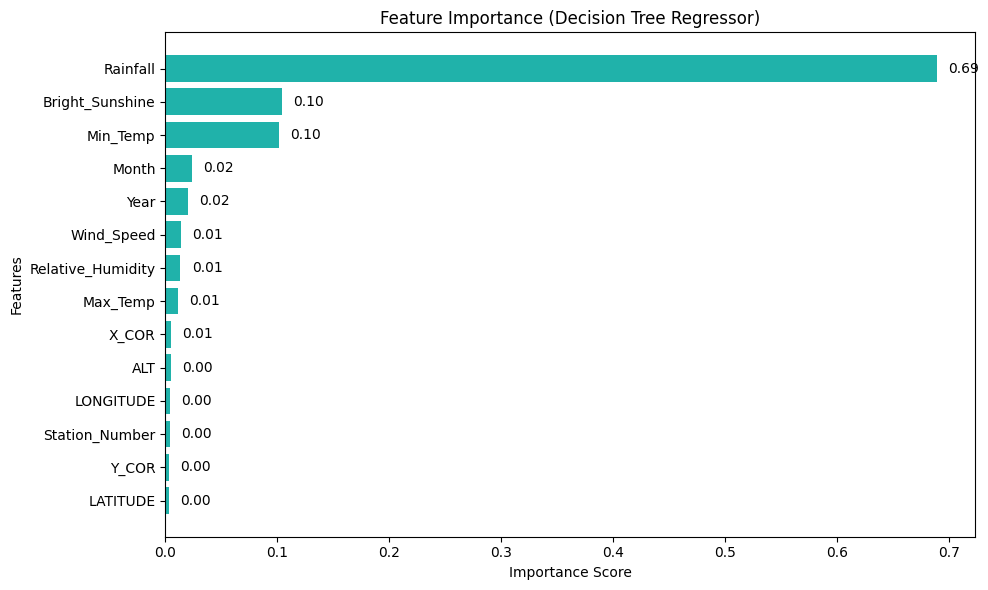

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
import pandas as pd
import matplotlib.pyplot as plt


X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


model = DecisionTreeRegressor(random_state=42)
model.fit(X_scaled, y)


feature_importances = model.feature_importances_


feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)

print(feature_importance_df)


plt.figure(figsize=(10, 6))
bars = plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='lightseagreen')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.title('Feature Importance (Decision Tree Regressor)')
plt.gca().invert_yaxis()


for bar in bars:
    plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height() / 2,
             f'{bar.get_width():.2f}', va='center', ha='left', color='black', fontsize=10)

plt.tight_layout()
plt.show()


##metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.653151  0.808178  0.574888  0.853392
1     2  0.734104  0.856799  0.616536  0.828028
2     3  0.625497  0.790884  0.571193  0.854871
3     4  0.718241  0.847491  0.600000  0.834337
4     5  0.757935  0.870595  0.621893  0.826409
5     6  0.754622  0.868690  0.608390  0.822456
6     7  0.633054  0.795647  0.569260  0.857017
7     8  0.754954  0.868881  0.620529  0.821936
8     9  0.759648  0.871578  0.618902  0.828457
9    10  0.611158  0.781766  0.570065  0.858751


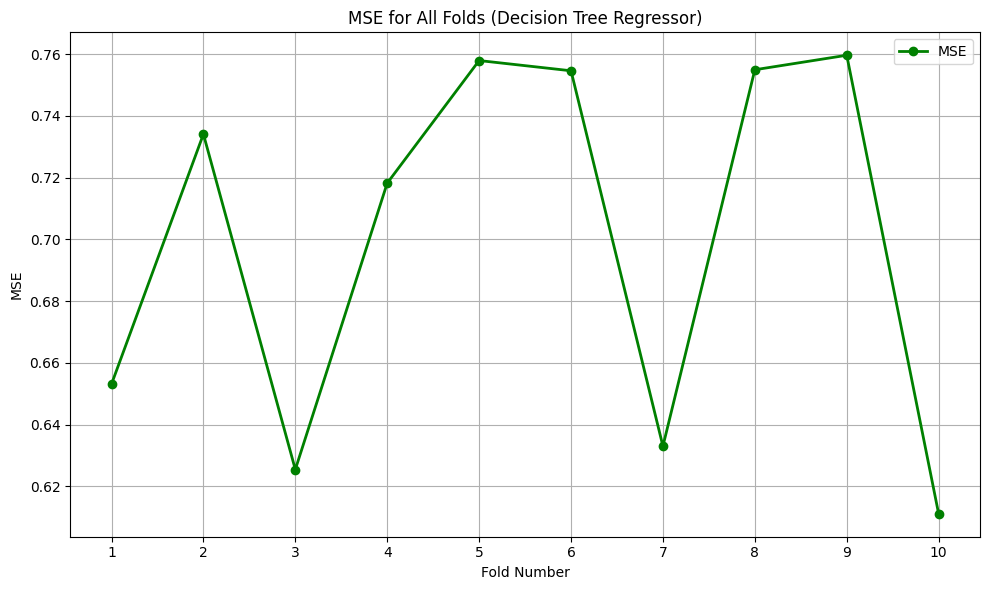

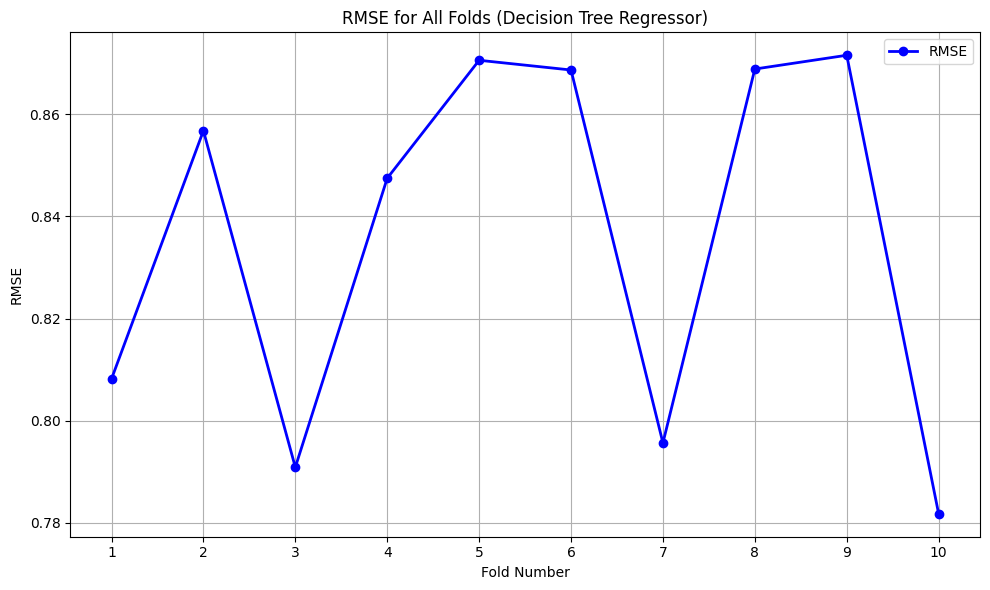

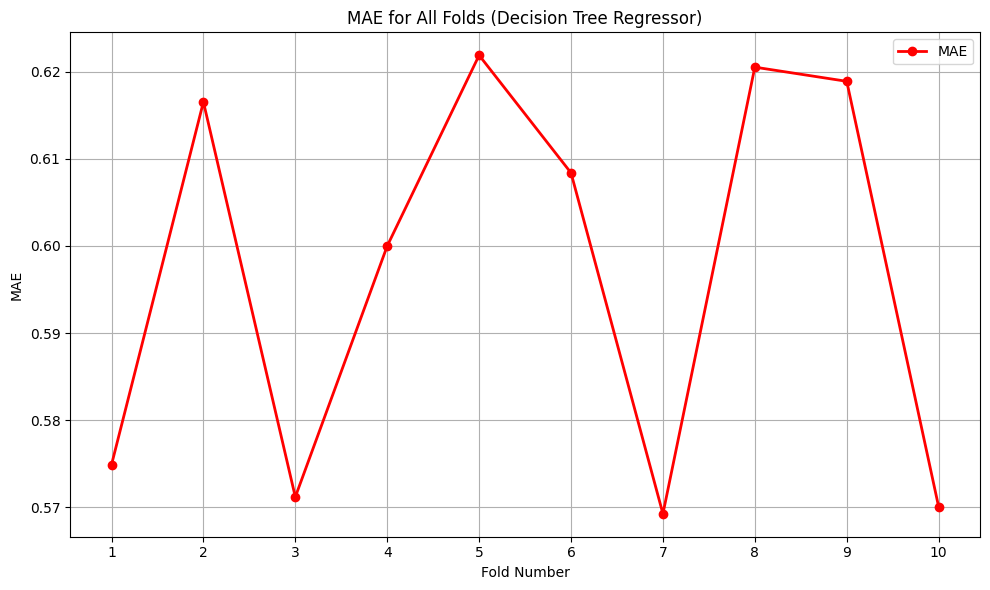

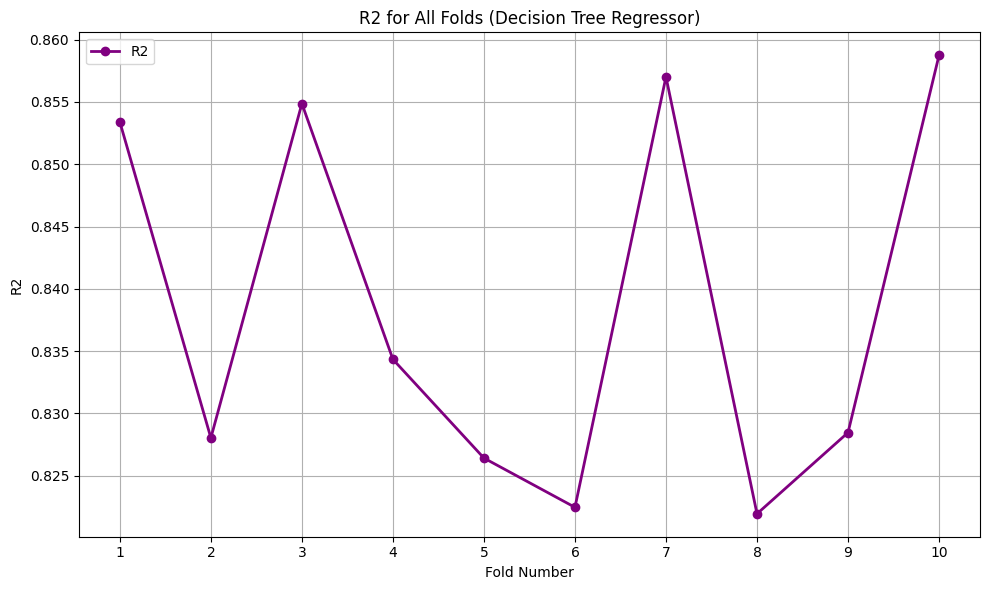


Best Fold Metrics (Fold 10.0):
Fold    10.000000
MSE      0.611158
RMSE     0.781766
MAE      0.570065
R2       0.858751
Name: 9, dtype: float64


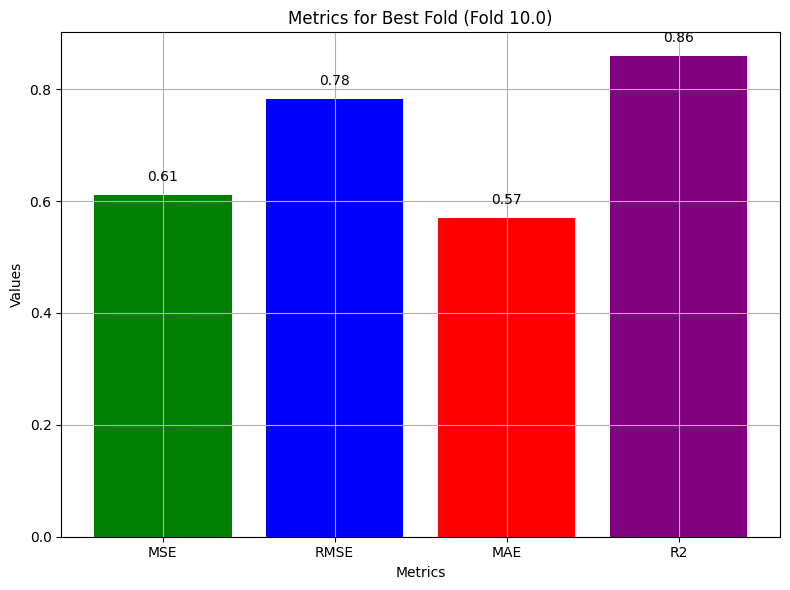

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = DecisionTreeRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_results = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })

fold_results_df = pd.DataFrame(fold_results)

best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]

print(fold_results_df)

plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (Decision Tree Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (Decision Tree Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (Decision Tree Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (Decision Tree Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")

metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])

for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)

ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)
plt.tight_layout()
plt.show()


##actual vs predicted graph

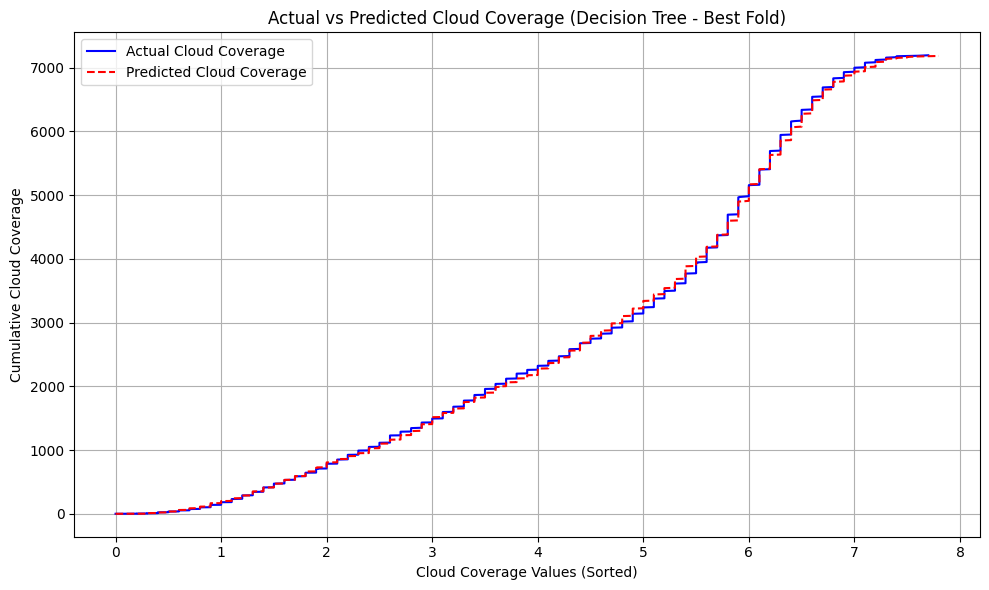

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = DecisionTreeRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for train_index, test_index in kf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))

best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

y_test_sorted = np.sort(y_test_best)
y_pred_sorted = np.sort(y_pred_best)

plt.figure(figsize=(10, 6))
plt.plot(y_test_sorted, np.cumsum(y_test_sorted), label='Actual Cloud Coverage', color='blue', linestyle='-', linewidth=1.5)
plt.plot(y_pred_sorted, np.cumsum(y_pred_sorted), label='Predicted Cloud Coverage', color='red', linestyle='--', linewidth=1.5)

plt.xlabel('Cloud Coverage Values (Sorted)')
plt.ylabel('Cumulative Cloud Coverage')
plt.title('Actual vs Predicted Cloud Coverage (Decision Tree - Best Fold)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


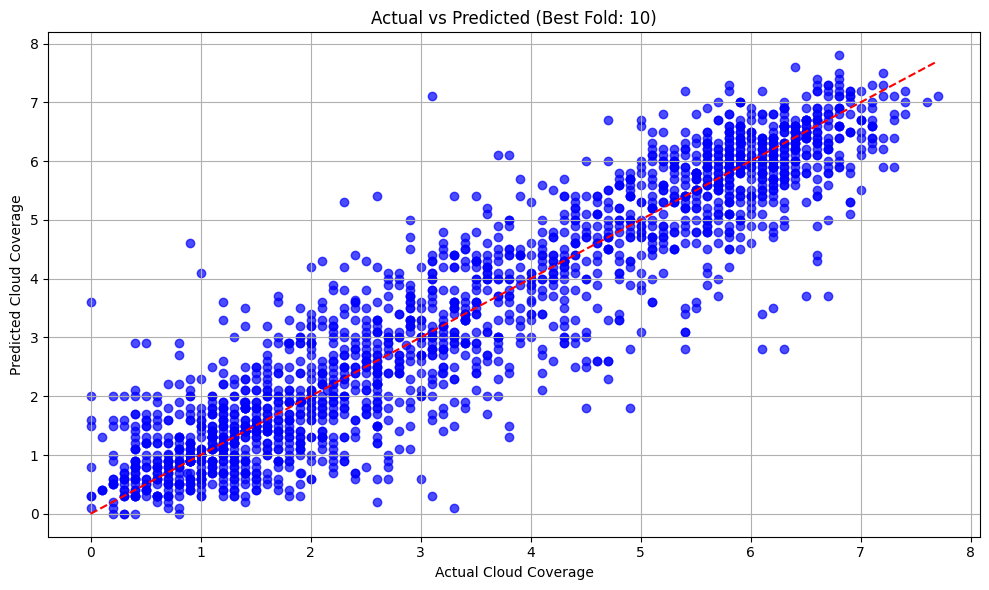

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = DecisionTreeRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))


best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

plt.figure(figsize=(10, 6))
plt.scatter(y_test_best, y_pred_best, color='blue', alpha=0.7)
plt.plot([min(y_test_best), max(y_test_best)], [min(y_test_best), max(y_test_best)], color='red', linestyle='--')
plt.xlabel('Actual Cloud Coverage')
plt.ylabel('Predicted Cloud Coverage')
plt.title(f'Actual vs Predicted (Best Fold: {best_fold_index + 1})')
plt.grid(True)
plt.tight_layout()
plt.show()


Best Fold: 10 with RMSE = 0.7818


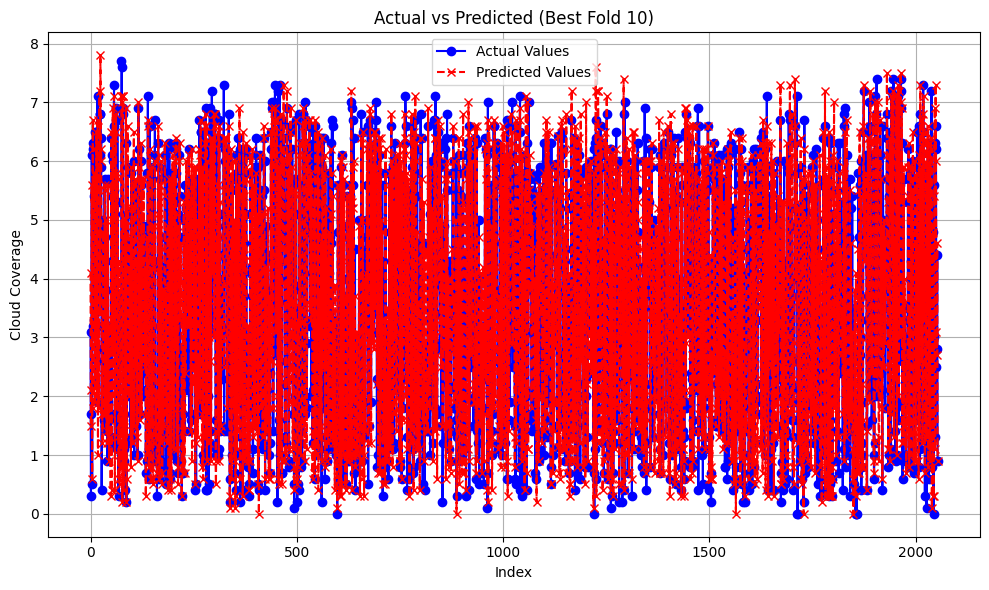

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = DecisionTreeRegressor(random_state=42)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

all_actual = []
all_predicted = []
fold_rmse = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    all_actual.extend(y_test)
    all_predicted.extend(y_pred)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)

best_fold = np.argmin(fold_rmse) + 1
print(f"Best Fold: {best_fold} with RMSE = {fold_rmse[best_fold - 1]:.4f}")

kf_split = kf.split(X, y)
for fold, (train_index, test_index) in enumerate(kf_split, start=1):
    if fold == best_fold:
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        plt.figure(figsize=(10, 6))
        plt.plot(range(len(y_test)), y_test, label='Actual Values', color='blue', linestyle='-', marker='o')
        plt.plot(range(len(y_pred)), y_pred, label='Predicted Values', color='red', linestyle='--', marker='x')
        plt.xlabel('Index')
        plt.ylabel('Cloud Coverage')
        plt.title(f'Actual vs Predicted (Best Fold {best_fold})')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        break


#KNN

##permutation importance method

              Feature    Importance
4            Rainfall  1.344204e+00
10              Y_COR  9.579186e-02
9               X_COR  9.356657e-02
0                Year  6.322969e-02
3            Min_Temp  2.979461e-02
5   Relative_Humidity  2.931883e-02
1               Month  2.496479e-03
2            Max_Temp  2.180840e-03
7     Bright_Sunshine  1.440411e-03
6          Wind_Speed  3.121678e-04
11           LATITUDE  0.000000e+00
12          LONGITUDE  0.000000e+00
13                ALT -1.757818e-07
8      Station_Number -2.511169e-07


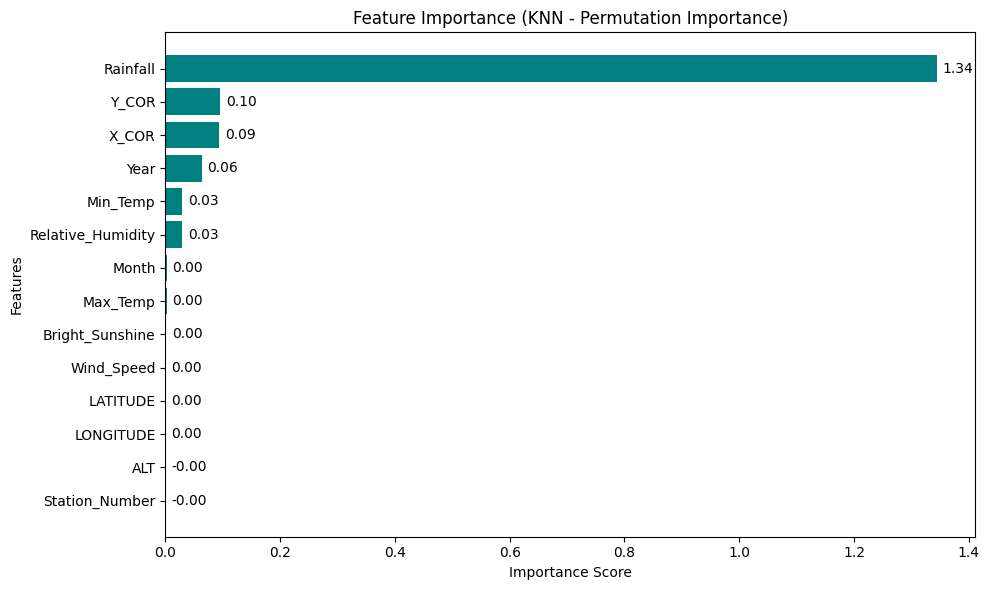

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.inspection import permutation_importance

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


model = KNeighborsRegressor()
model.fit(X, y)


result = permutation_importance(model, X, y, n_repeats=10, random_state=42)


feature_importances = result.importances_mean


feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
}).sort_values(by='Importance', ascending=False)


print(feature_importance_df)


plt.figure(figsize=(10, 6))
bars = plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='teal')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.title('Feature Importance (KNN - Permutation Importance)')
plt.gca().invert_yaxis()


for bar in bars:
    plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height() / 2,
             f'{bar.get_width():.2f}', va='center', ha='left', color='black', fontsize=10)

plt.tight_layout()
plt.show()


##k=1, cross validation & metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.617244  0.785649  0.570154  0.861452
1     2  0.601680  0.775681  0.567270  0.859050
2     3  0.558062  0.747036  0.561306  0.870517
3     4  0.656829  0.810450  0.577354  0.848501
4     5  0.585439  0.765140  0.553118  0.865916
5     6  0.596713  0.772472  0.549303  0.859608
6     7  0.539802  0.734712  0.541752  0.878079
7     8  0.620797  0.787907  0.580954  0.853578
8     9  0.647836  0.804882  0.584340  0.853707
9    10  0.580177  0.761694  0.552599  0.865911


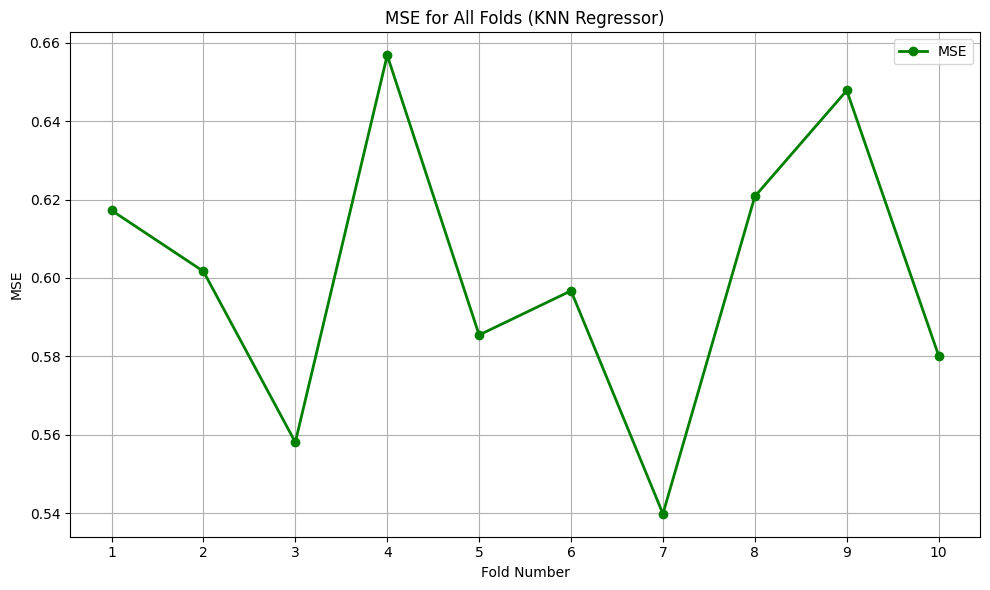

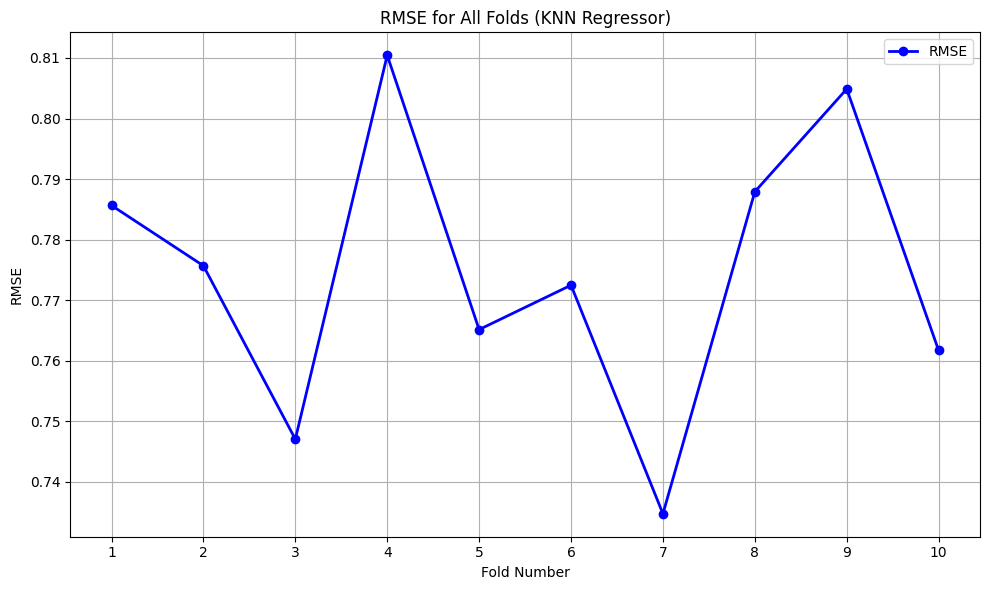

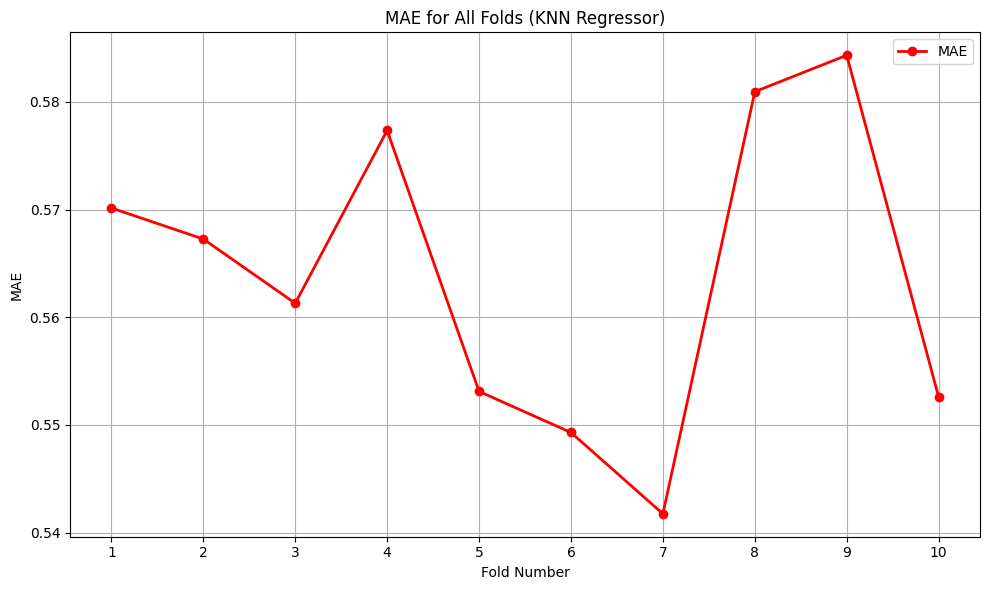

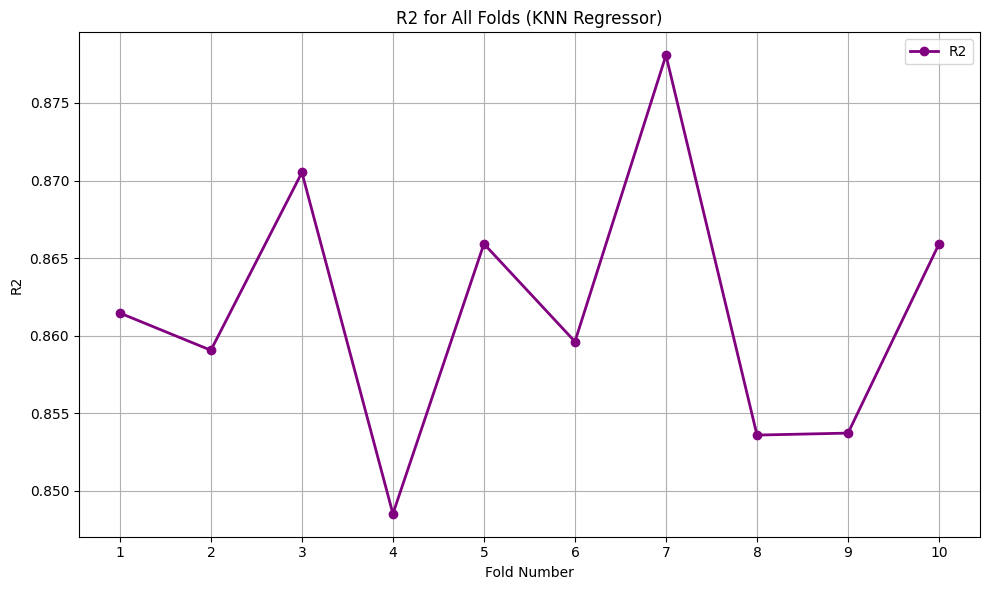


Best Fold Metrics (Fold 7.0):
Fold    7.000000
MSE     0.539802
RMSE    0.734712
MAE     0.541752
R2      0.878079
Name: 6, dtype: float64


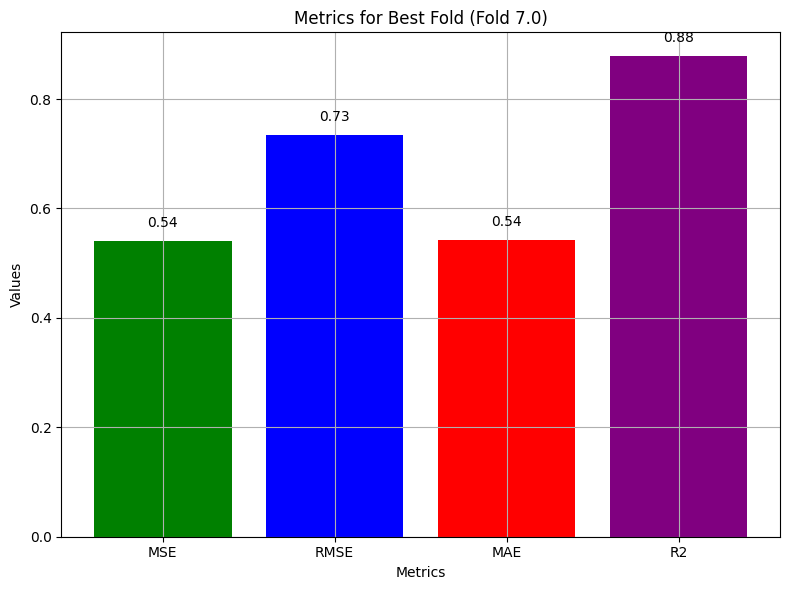

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


model = KNeighborsRegressor(n_neighbors=1)


kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_results = []


for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)


    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)


    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)


    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })


fold_results_df = pd.DataFrame(fold_results)


best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]


print(fold_results_df)


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (KNN Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (KNN Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (KNN Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (KNN Regressor)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")


metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])


for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)

ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)
plt.tight_layout()
plt.show()


##k=3, cross validation & metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.396617  0.629775  0.464405  0.910974
1     2  0.409367  0.639818  0.477232  0.904102
2     3  0.385019  0.620499  0.470850  0.910667
3     4  0.431005  0.656509  0.485792  0.900588
4     5  0.412596  0.642336  0.470710  0.905502
5     6  0.401383  0.633548  0.463677  0.905565
6     7  0.395412  0.628818  0.458533  0.910691
7     8  0.418875  0.647206  0.478220  0.901204
8     9  0.432860  0.657921  0.478494  0.902252
9    10  0.427845  0.654098  0.482571  0.901118


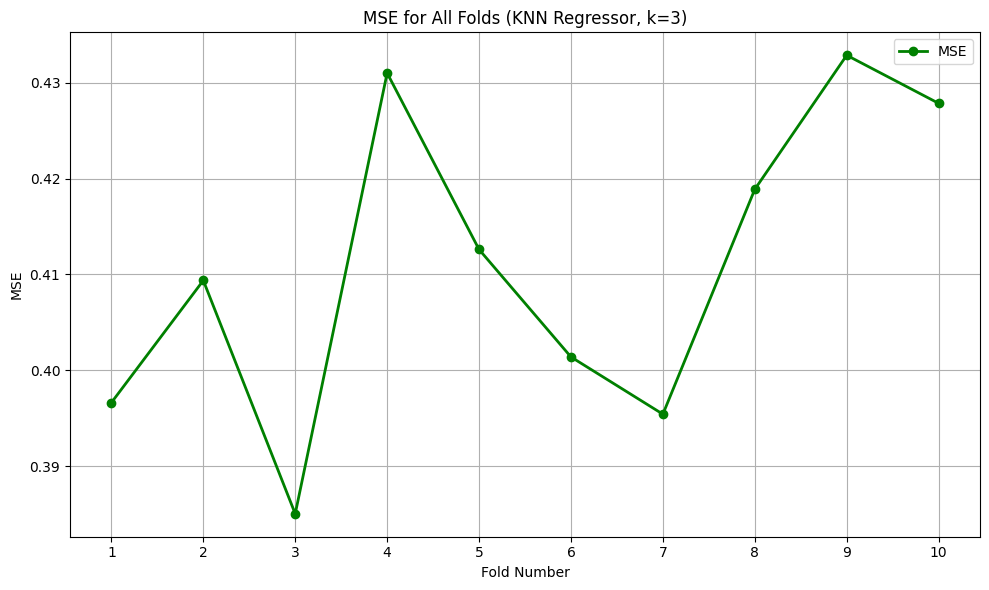

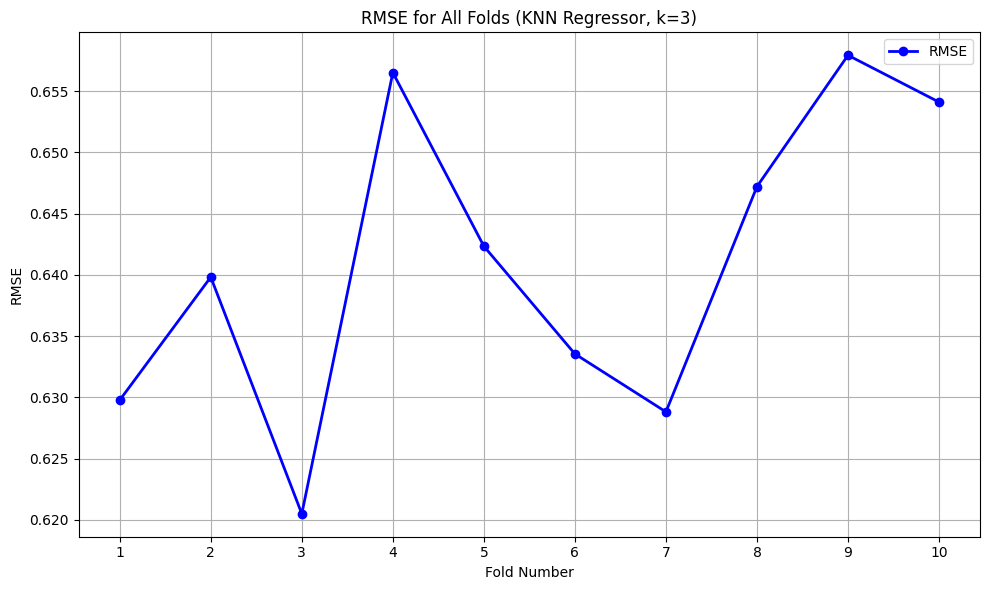

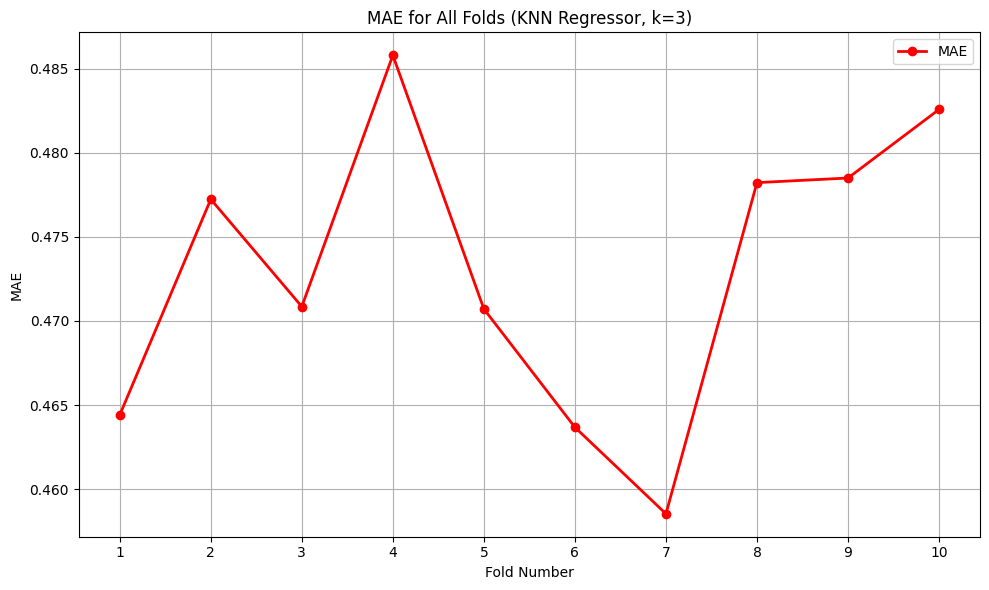

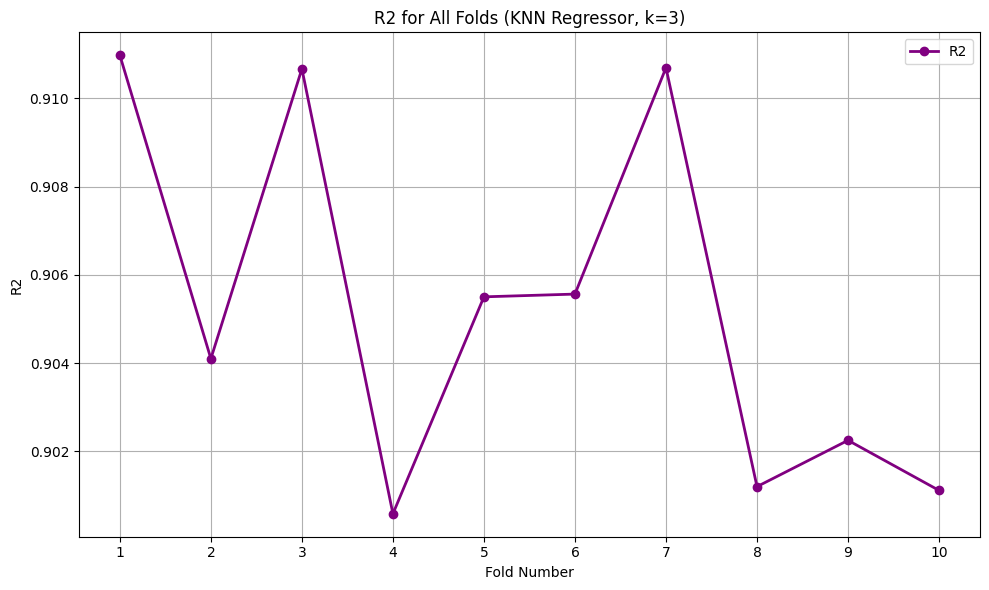


Best Fold Metrics (Fold 3.0):
Fold    3.000000
MSE     0.385019
RMSE    0.620499
MAE     0.470850
R2      0.910667
Name: 2, dtype: float64


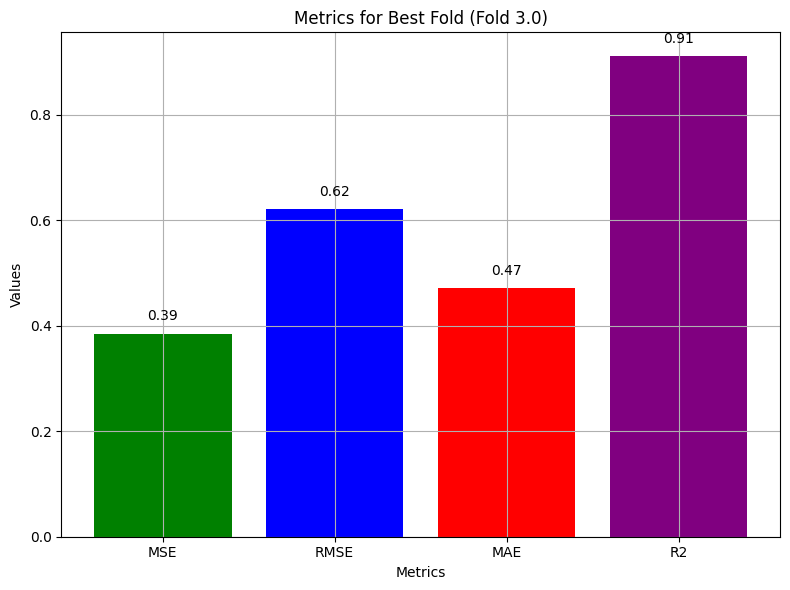

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


model = KNeighborsRegressor(n_neighbors=3)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_results = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)


    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })

fold_results_df = pd.DataFrame(fold_results)


best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]


print(fold_results_df)




plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (KNN Regressor, k=3)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (KNN Regressor, k=3)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (KNN Regressor, k=3)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (KNN Regressor, k=3)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()


print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")


metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])


for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)

ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)
plt.tight_layout()
plt.show()


##k=5, cross validation & metrics values

   Fold       MSE      RMSE       MAE        R2
0     1  0.363446  0.602865  0.450341  0.918420
1     2  0.382886  0.618778  0.462995  0.910305
2     3  0.372008  0.609924  0.460858  0.913686
3     4  0.415817  0.644838  0.471706  0.904091
4     5  0.396160  0.629412  0.463773  0.909267
5     6  0.376204  0.613355  0.450959  0.911489
6     7  0.380007  0.616447  0.452992  0.914171
7     8  0.394865  0.628383  0.458862  0.906867
8     9  0.417031  0.645779  0.466814  0.905827
9    10  0.389045  0.623735  0.460473  0.910085


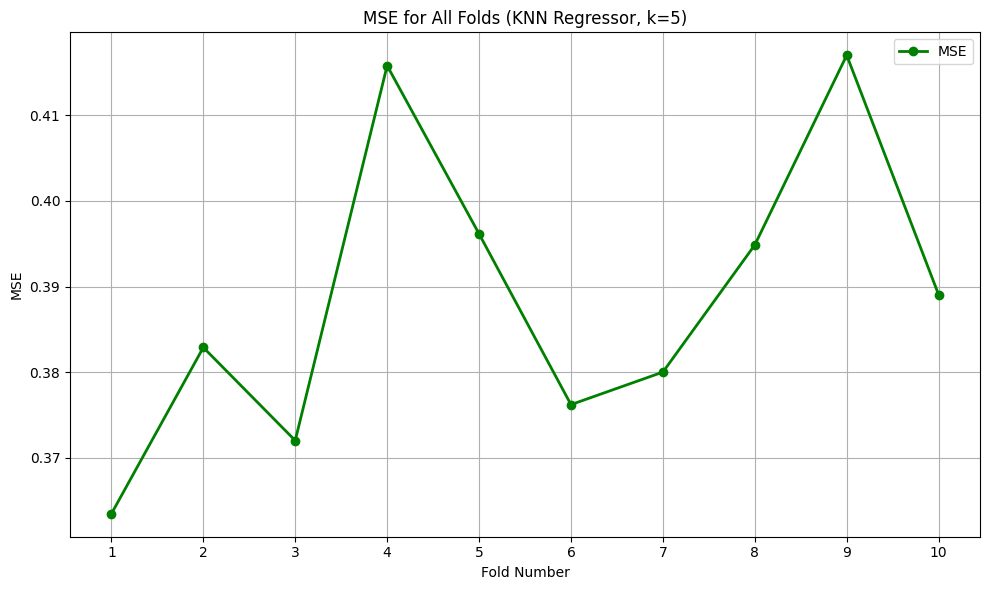

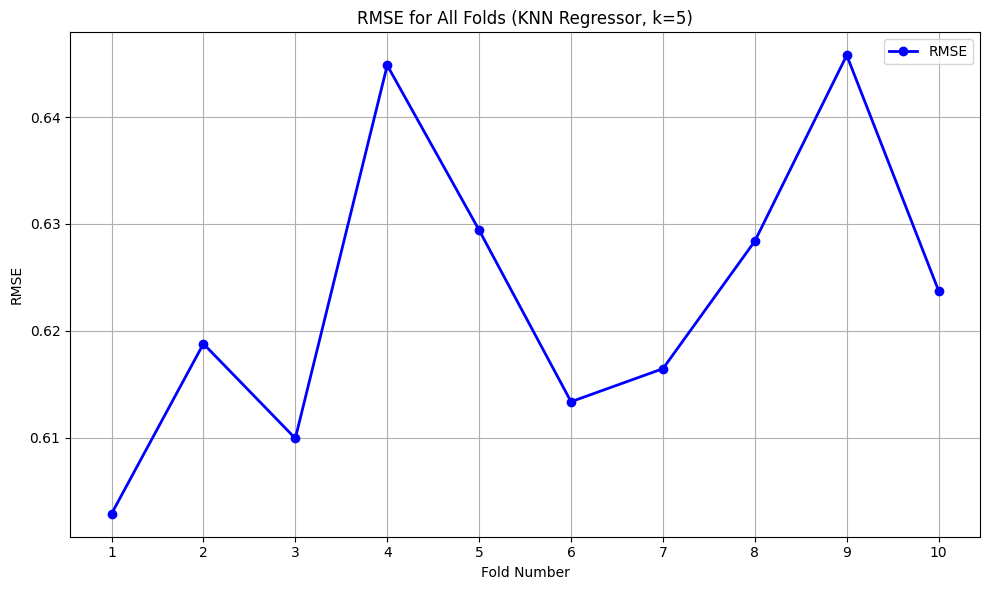

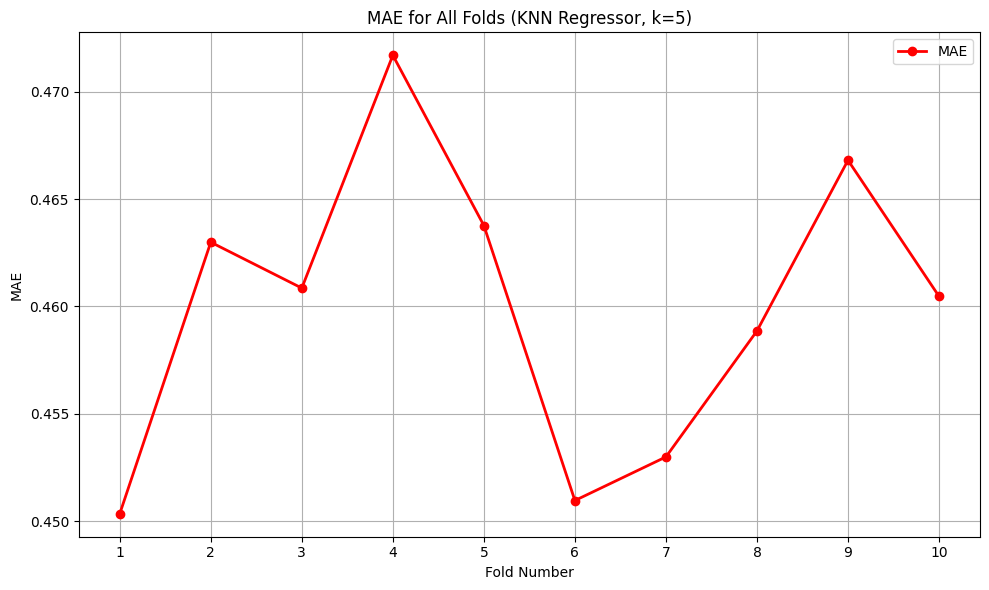

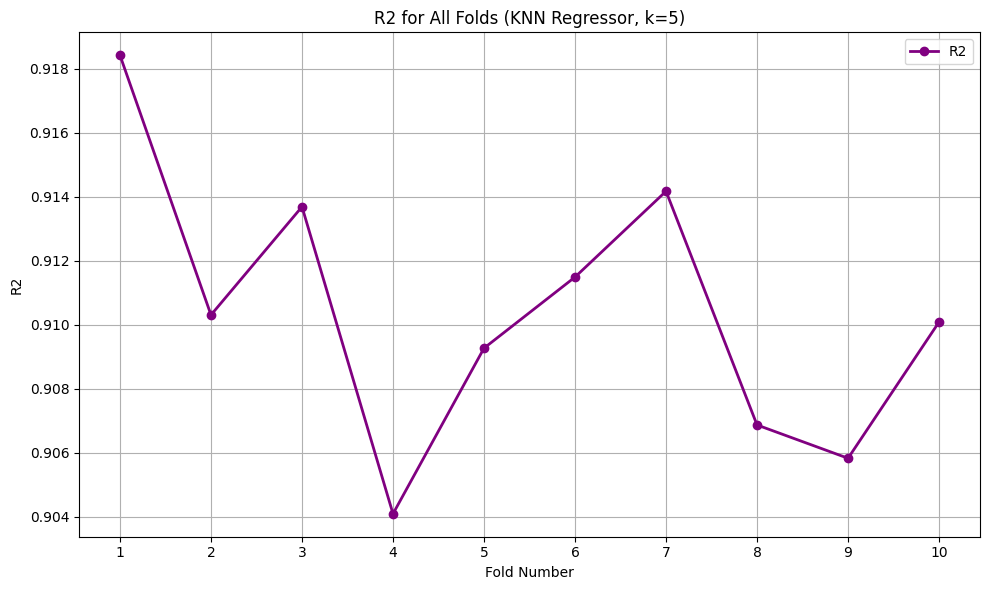


Best Fold Metrics (Fold 1.0):
Fold    1.000000
MSE     0.363446
RMSE    0.602865
MAE     0.450341
R2      0.918420
Name: 0, dtype: float64


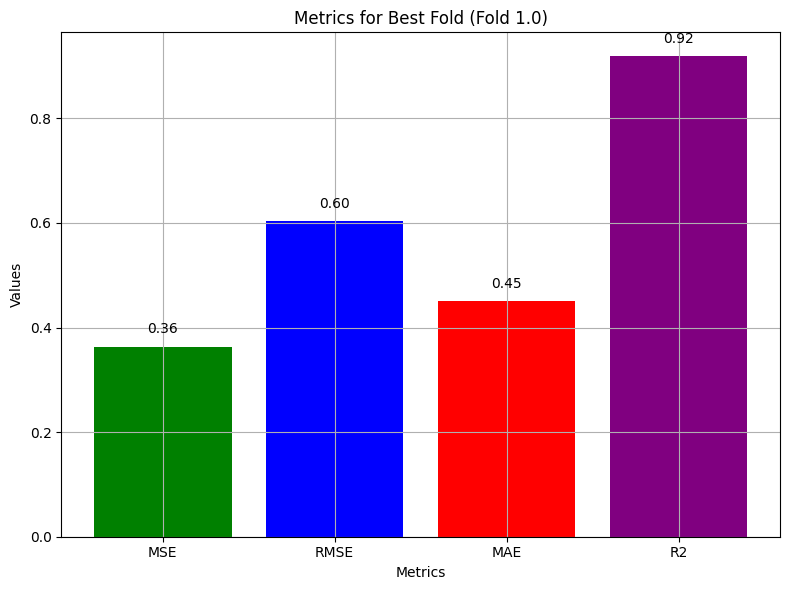

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


model = KNeighborsRegressor(n_neighbors=5)


kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_results = []


for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)


    model.fit(X_train_scaled, y_train)


    y_pred = model.predict(X_test_scaled)

    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store results
    fold_results.append({
        "Fold": fold,
        "MSE": mse,
        "RMSE": rmse,
        "MAE": mae,
        "R2": r2
    })

# Convert results to a DataFrame
fold_results_df = pd.DataFrame(fold_results)

# Get the best fold based on minimum RMSE
best_fold = fold_results_df.loc[fold_results_df['RMSE'].idxmin()]

# Display results for all folds
print(fold_results_df)

# Plot metrics for all folds

# MSE Plot
plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MSE'], marker='o', color='g', label='MSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MSE')
plt.title('MSE for All Folds (KNN Regressor, k=5)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

# RMSE Plot
plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['RMSE'], marker='o', color='b', label='RMSE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('RMSE')
plt.title('RMSE for All Folds (KNN Regressor, k=5)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

# MAE Plot
plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['MAE'], marker='o', color='r', label='MAE', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('MAE')
plt.title('MAE for All Folds (KNN Regressor, k=5)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

# R2 Plot
plt.figure(figsize=(10, 6))
plt.plot(fold_results_df['Fold'], fold_results_df['R2'], marker='o', color='purple', label='R2', linestyle='-', linewidth=2)
plt.xlabel('Fold Number')
plt.ylabel('R2')
plt.title('R2 for All Folds (KNN Regressor, k=5)')
plt.grid(True)
plt.xticks(fold_results_df['Fold'])
plt.legend()
plt.tight_layout()
plt.show()

# Print the best fold metrics
print(f"\nBest Fold Metrics (Fold {best_fold['Fold']}):\n{best_fold}")

# Bar Plot for Best Fold Metrics
metrics = ['MSE', 'RMSE', 'MAE', 'R2']
best_values = [best_fold[metric] for metric in metrics]

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(metrics, best_values, color=['g', 'b', 'r', 'purple'])

# Display the values on top of the bars
for bar, value in zip(bars, best_values):
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{value:.2f}', ha='center', va='bottom', fontsize=10)

ax.set_xlabel('Metrics')
ax.set_ylabel('Values')
ax.set_title(f'Metrics for Best Fold (Fold {best_fold["Fold"]})')
ax.grid(True)
plt.tight_layout()
plt.show()


##actual vs predicted graph (K=5)

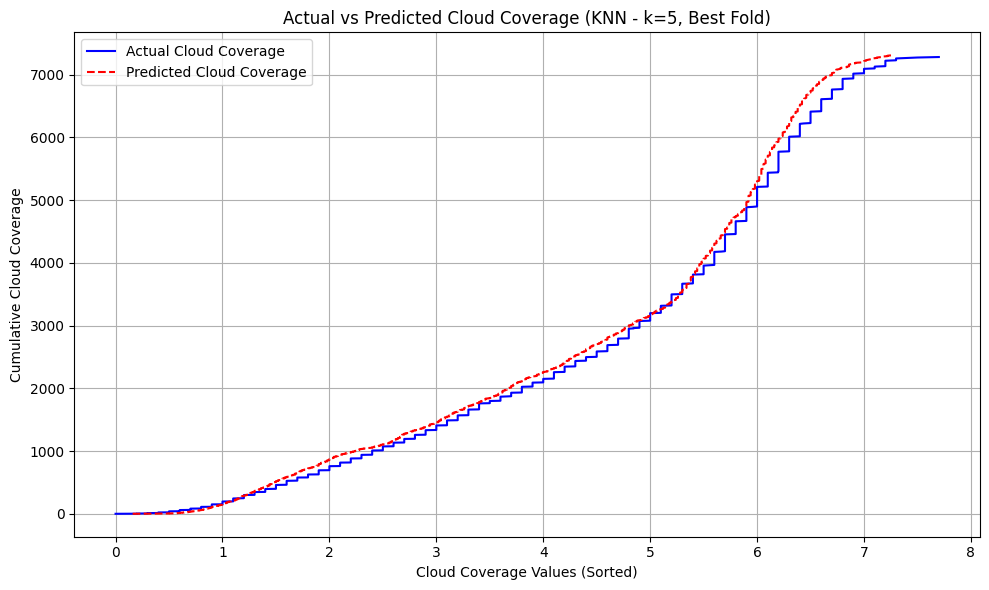

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = KNeighborsRegressor(n_neighbors=5)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for train_index, test_index in kf.split(X, y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))

best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

y_test_sorted = np.sort(y_test_best)
y_pred_sorted = np.sort(y_pred_best)

plt.figure(figsize=(10, 6))
plt.plot(y_test_sorted, np.cumsum(y_test_sorted), label='Actual Cloud Coverage', color='blue', linestyle='-', linewidth=1.5)
plt.plot(y_pred_sorted, np.cumsum(y_pred_sorted), label='Predicted Cloud Coverage', color='red', linestyle='--', linewidth=1.5)

plt.xlabel('Cloud Coverage Values (Sorted)')
plt.ylabel('Cumulative Cloud Coverage')
plt.title('Actual vs Predicted Cloud Coverage (KNN - k=5, Best Fold)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


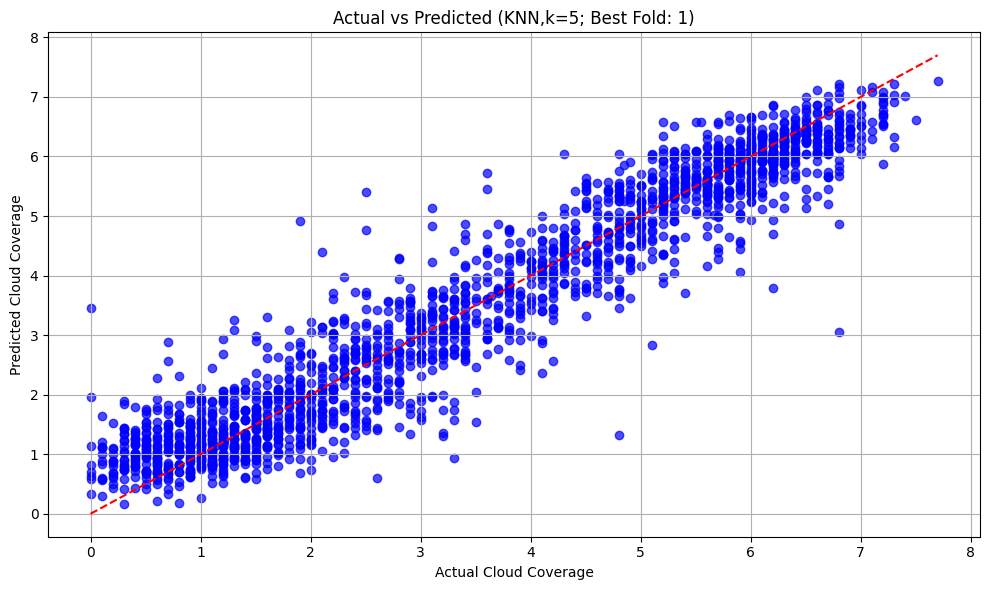

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = KNeighborsRegressor(n_neighbors=5)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

fold_rmse = []
fold_data = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)
    fold_data.append((y_test, y_pred))


best_fold_index = np.argmin(fold_rmse)
y_test_best, y_pred_best = fold_data[best_fold_index]

plt.figure(figsize=(10, 6))
plt.scatter(y_test_best, y_pred_best, color='blue', alpha=0.7)
plt.plot([min(y_test_best), max(y_test_best)], [min(y_test_best), max(y_test_best)], color='red', linestyle='--')
plt.xlabel('Actual Cloud Coverage')
plt.ylabel('Predicted Cloud Coverage')
plt.title(f'Actual vs Predicted (KNN,k=5; Best Fold: {best_fold_index + 1})')
plt.grid(True)
plt.tight_layout()
plt.show()


Best Fold: 1 with RMSE = 0.6029


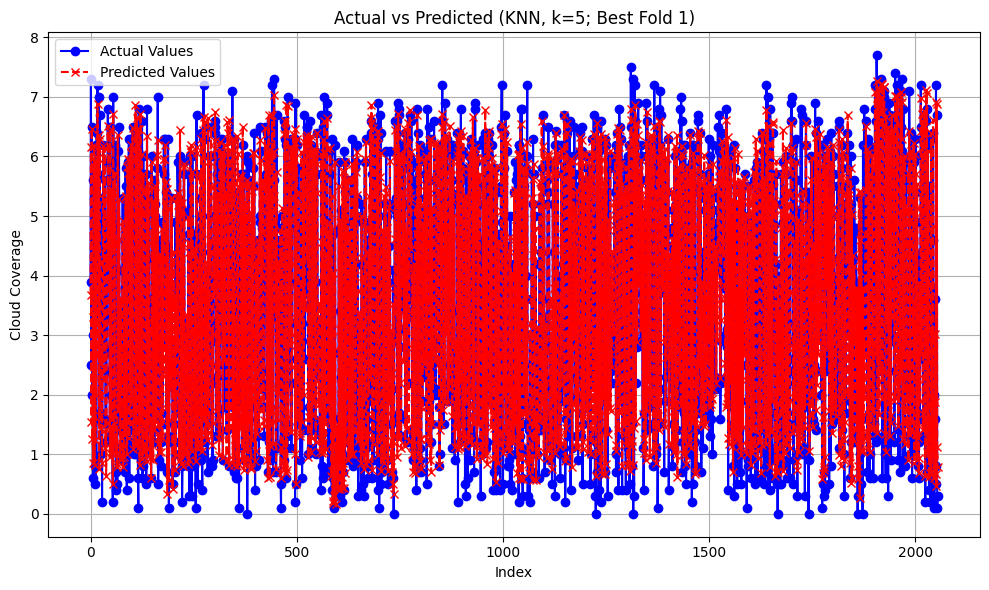

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]

model = KNeighborsRegressor(n_neighbors=5)

kf = KFold(n_splits=10, shuffle=True, random_state=42)

all_actual = []
all_predicted = []
fold_rmse = []

for fold, (train_index, test_index) in enumerate(kf.split(X, y), start=1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    all_actual.extend(y_test)
    all_predicted.extend(y_pred)

    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    fold_rmse.append(rmse)

best_fold = np.argmin(fold_rmse) + 1
print(f"Best Fold: {best_fold} with RMSE = {fold_rmse[best_fold - 1]:.4f}")

kf_split = kf.split(X, y)
for fold, (train_index, test_index) in enumerate(kf_split, start=1):
    if fold == best_fold:
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        plt.figure(figsize=(10, 6))
        plt.plot(range(len(y_test)), y_test, label='Actual Values', color='blue', linestyle='-', marker='o')
        plt.plot(range(len(y_pred)), y_pred, label='Predicted Values', color='red', linestyle='--', marker='x')
        plt.xlabel('Index')
        plt.ylabel('Cloud Coverage')
        plt.title(f'Actual vs Predicted (KNN, k=5; Best Fold {best_fold})')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        break


#All models Actual vs predicted values graph

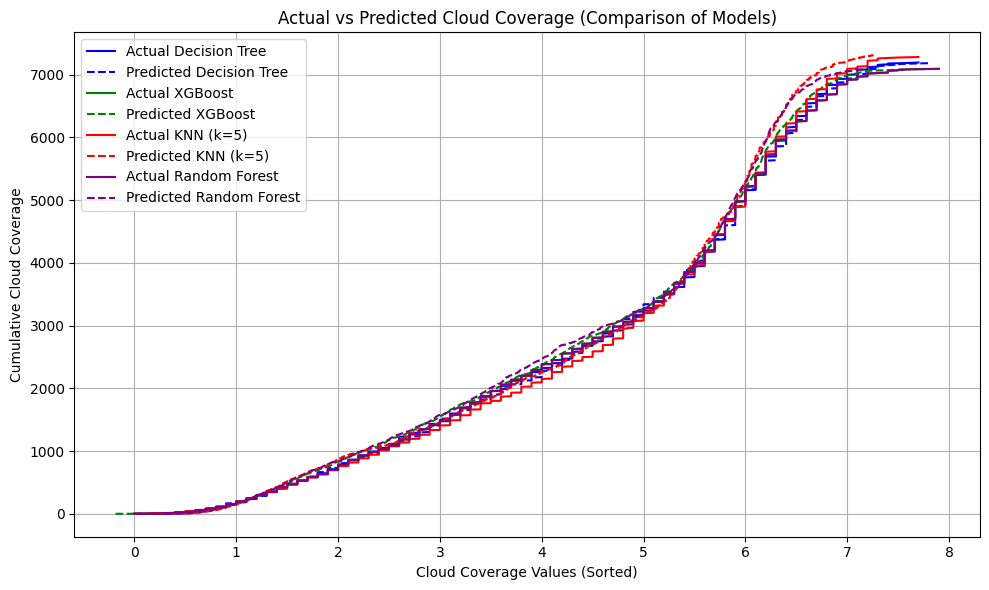

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error


X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


models = {
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "XGBoost": XGBRegressor(random_state=42),
    "KNN (k=5)": KNeighborsRegressor(n_neighbors=5),
    "Random Forest": RandomForestRegressor(random_state=42)
}


kf = KFold(n_splits=10, shuffle=True, random_state=42)


results = {
    "Decision Tree": [],
    "XGBoost": [],
    "KNN (k=5)": [],
    "Random Forest": []
}


for model_name, model in models.items():
    fold_rmse = []
    fold_data = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        fold_rmse.append(rmse)
        fold_data.append((y_test, y_pred))


    best_fold_index = np.argmin(fold_rmse)
    y_test_best, y_pred_best = fold_data[best_fold_index]

    results[model_name].append((y_test_best, y_pred_best))


plt.figure(figsize=(10, 6))

colors = ['blue', 'green', 'red', 'purple']


for i, (model_name, data) in enumerate(results.items()):
    y_test_best, y_pred_best = data[0]

    y_test_sorted = np.sort(y_test_best)
    y_pred_sorted = np.sort(y_pred_best)

    plt.plot(y_test_sorted, np.cumsum(y_test_sorted), label=f'Actual {model_name}', color=colors[i], linestyle='-', linewidth=1.5)
    plt.plot(y_pred_sorted, np.cumsum(y_pred_sorted), label=f'Predicted {model_name}', color=colors[i], linestyle='--', linewidth=1.5)


plt.xlabel('Cloud Coverage Values (Sorted)')
plt.ylabel('Cumulative Cloud Coverage')
plt.title('Actual vs Predicted Cloud Coverage (Comparison of Models)')
plt.legend()
plt.grid(True)
plt.tight_layout()

plt.show()


#All models best fold metrics values

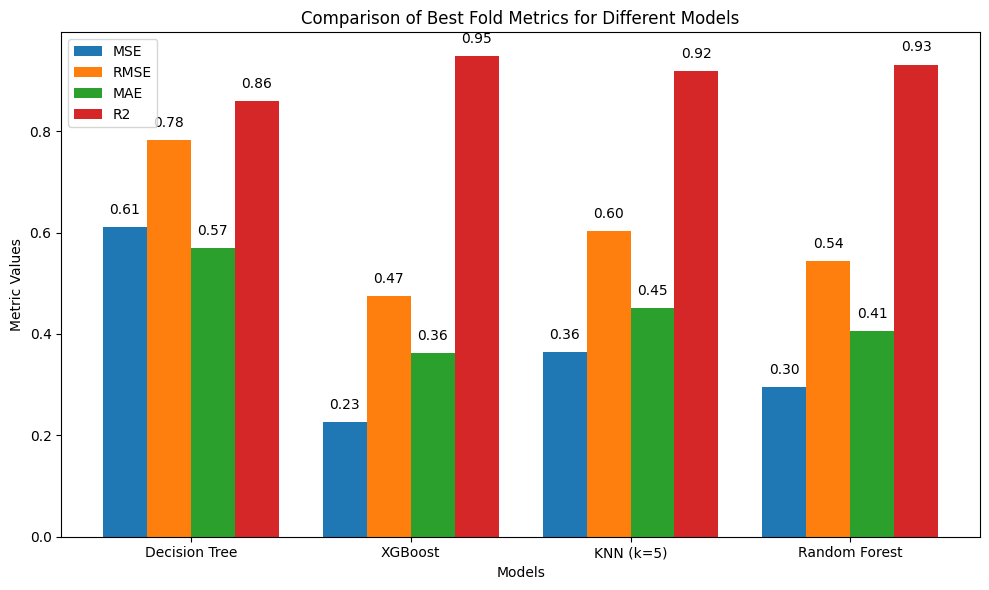

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from xgboost import XGBRegressor
from sklearn.neighbors import KNeighborsRegressor


X = df.drop(columns=["Cloud_Coverage"])
y = df["Cloud_Coverage"]


models = {
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "XGBoost": XGBRegressor(random_state=42),
    "KNN (k=5)": KNeighborsRegressor(n_neighbors=5),
    "Random Forest": RandomForestRegressor(random_state=42)
}


kf = KFold(n_splits=10, shuffle=True, random_state=42)


best_fold_metrics = {
    "Model": [],
    "MSE": [],
    "RMSE": [],
    "MAE": [],
    "R2": []
}


for model_name, model in models.items():
    fold_metrics = []

    for train_index, test_index in kf.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        model.fit(X_train_scaled, y_train)

        y_pred = model.predict(X_test_scaled)

        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)

        fold_metrics.append({
            "MSE": mse,
            "RMSE": rmse,
            "MAE": mae,
            "R2": r2
        })


    best_fold = min(fold_metrics, key=lambda x: x["RMSE"])

    best_fold_metrics["Model"].append(model_name)
    best_fold_metrics["MSE"].append(best_fold["MSE"])
    best_fold_metrics["RMSE"].append(best_fold["RMSE"])
    best_fold_metrics["MAE"].append(best_fold["MAE"])
    best_fold_metrics["R2"].append(best_fold["R2"])


metrics_df = pd.DataFrame(best_fold_metrics)


fig, ax = plt.subplots(figsize=(10, 6))

metrics = ['MSE', 'RMSE', 'MAE', 'R2']


bar_width = 0.2
index = np.arange(len(models))


for i, metric in enumerate(metrics):
    bars = ax.bar(index + i * bar_width, metrics_df[metric], bar_width, label=metric)


    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2, height + 0.02, f'{height:.2f}', ha='center', va='bottom', fontsize=10)


ax.set_xlabel('Models')
ax.set_ylabel('Metric Values')
ax.set_title('Comparison of Best Fold Metrics for Different Models')
ax.set_xticks(index + bar_width * 1.5)
ax.set_xticklabels(metrics_df["Model"])
ax.legend()

plt.tight_layout()
plt.show()


#User Input and prediction

In [ ]:
X = df.drop(columns=["Cloud_Coverage", "Station_Number"])
y = df["Cloud_Coverage"]
station_numbers = df["Station_Number"]

model = XGBRegressor(random_state=42)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

model.fit(X_scaled, y)

user_year = int(input("Enter a year after 2013 for cloud coverage prediction: "))
user_month = int(input("Enter a month (1-12) for cloud coverage prediction: "))

user_features = np.random.rand(1, X.shape[1])
user_features_scaled = scaler.transform(user_features)

predicted_cloud_coverage = model.predict(user_features_scaled)

df_predictions = pd.DataFrame({
    'Station_Number': station_numbers,
    'Predicted_Cloud_Coverage': model.predict(X_scaled)
})

station_grouped = df_predictions.groupby('Station_Number')['Predicted_Cloud_Coverage'].mean()

plt.figure(figsize=(12, 6))
station_grouped.plot(kind='bar', color='skyblue')
plt.xlabel('Station Number')
plt.ylabel('Predicted Cloud Coverage')
plt.title(f'Predicted Cloud Coverage for Stations ({user_month}/{user_year})')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
